## Exploratory Data Analysis using Telegram data
#### Author: `Dmytro Avdieienko`

In [1]:
import pandas as pd
import matplotlib.pyplot as plt
import numpy as np
import seaborn as sns
from datetime import datetime
from collections import Counter
import ast
from collections import defaultdict
import plotly.graph_objects as go
from IPython.display import display, HTML
from plotly.subplots import make_subplots
import plotly.express as px
from typing import Dict, List, Tuple, Set
from tqdm import tqdm
import re
import itertools
from matplotlib.dates import MonthLocator, DateFormatter

In [2]:
DIALOGS_MERGED_DATA_PATH = "../data/merged_data/dialogs_data_all.csv"
DIALOGS_META_MERGED_DATA_PATH = "../data/merged_data/dialogs_users_all.csv"

In [3]:
df = pd.read_csv(DIALOGS_MERGED_DATA_PATH)
df_meta = pd.read_csv(DIALOGS_META_MERGED_DATA_PATH)

C:\Users\Dmytro\AppData\Local\Temp\ipykernel_5652\995574815.py:1: DtypeWarning: Columns (2,3,4,8) have mixed types. Specify dtype option on import or set low_memory=False.
  df = pd.read_csv(DIALOGS_MERGED_DATA_PATH)


## Check data

In [4]:
df.head(5)

,id,date,from_id,to_id,fwd_from,message,type,duration,reactions,dialog_id
0,381,2024-11-18 18:44:19+00:00,NaN,PeerChannel(channel_id=1006503122),NaN,NaN,video,10.0,NaN,-1001006503122
1,380,2024-11-18 18:44:19+00:00,NaN,PeerChannel(channel_id=1006503122),NaN,NaN,video,15.0,NaN,-1001006503122
2,379,2024-11-18 18:44:18+00:00,NaN,PeerChannel(channel_id=1006503122),NaN,NaN,video,8.0,NaN,-1001006503122
3,378,2024-11-18 18:44:18+00:00,NaN,PeerChannel(channel_id=1006503122),NaN,NaN,video,15.0,NaN,-1001006503122
4,377,2024-11-18 18:44:17+00:00,NaN,PeerChannel(channel_id=1006503122),NaN,NaN,video,5.0,NaN,-1001006503122


In [5]:
df.shape

(5085233, 10)

In [6]:
min(df["date"]),max(df["date"])

('2015-10-28 18:20:58+00:00', '2024-11-21 22:52:44+00:00')

In [7]:
df.groupby(["type"])["type"].count()

type
photo       850808
sticker      66070
text       3940014
video       214152
voice        14189
Name: type, dtype: int64

In [8]:
df.groupby(["type"])["duration"].sum()

type
photo             0.0
sticker           0.0
text              0.0
video      15191877.0
voice        296170.0
Name: duration, dtype: float64

Users

In [9]:
df_meta.shape

(16610, 4)

In [10]:
df_meta.head(10)

,dialog_id,name,type,users
0,-1001142723513,ФІ,Group,"{'user_id': 679210513, 'first_name': 'Тоха', '..."
1,-1001142723513,ФІ,Group,"{'user_id': 749006059, 'first_name': 'Твій дом..."
2,-1001142723513,ФІ,Group,"{'user_id': 519270613, 'first_name': 'Діма', '..."
3,-1001142723513,ФІ,Group,"{'user_id': 701650957, 'first_name': 'Слава', ..."
4,-1001142723513,ФІ,Group,"{'user_id': 772664687, 'first_name': 'Ярослав'..."
5,-1001142723513,ФІ,Group,"{'user_id': 416950266, 'first_name': 'Ваня', '..."
6,-1001142723513,ФІ,Group,"{'user_id': 398760267, 'first_name': 'Андрій',..."
7,-1001142723513,ФІ,Group,"{'user_id': 599821131, 'first_name': 'афина', ..."
8,-1001142723513,ФІ,Group,"{'user_id': 712865030, 'first_name': 'Olesia',..."
9,-1001142723513,ФІ,Group,"{'user_id': 855734991, 'first_name': 'Богдан',..."


In [11]:
df_meta.groupby(["type"])["type"].count()

type
Channel              84
Group             16274
Private dialog      252
Name: type, dtype: int64

## Questions to explore

1. Порівняти кількість повідомлень за місяць в топ 5/топ 10 особистих чатах за кількістю повідомлень
2. Відсоток повідомлень в топ5 / 10 особистих чатах
3. Динаміка повідомлень які я пишу в особисті та в групи
4. Розподіл днів, коли я написав найбільшу кількість повідомлень
5. Кількість використаних мною реакцій
6. Частота найбільш вживаних реакцій
7. Мої повідомлення з найбільшою кількістю реакцій
8. Топ 3 реакції в топ 10 особистих чатів
9. Порівняння топ реакцій людини в особистому чаті та у всіх спільних чатах
10. 10 найпопулярніших (по реакціях) повідомлень в групах
11. Полярна діаграма відпралених мною повідомлень в різні години доби
12. Залежність кількості написаних мною повідомлень від часу доби та дня тижня
13. Зведена статистика по активності в різні години/дні/місяці
14. Виявлення найбільш активних груп (найбільша кількість повідомлень на 1 учасника)
15. Виявлення однакових повідомлень
16. Аналіз використання могилянських жаргонізмів у чатах. Спроба знайти їх в напопулярніших повідомленнях за реакціями
17. Пошук використання жаргонізмів у деяких чатах. Виведення найбільш вживаних
18. Візуалізації використання жаргонізмів у могилянських чатах. Динаміка за місяцями.

### 1. Порівняти кількість повідомлень за місяць в топ 5/топ 10 особистих чатах за кількістю повідомлень

**Вступ**

Цікаво дізнатися динаміку того, з ким переважно я спілкувався протягом кожного місяця. Для цього використана звичайна лінійна діаграма

C:\Users\Dmytro\AppData\Local\Temp\ipykernel_5652\656544145.py:6: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  private_messages.loc[:, 'date'] = pd.to_datetime(private_messages['date'])


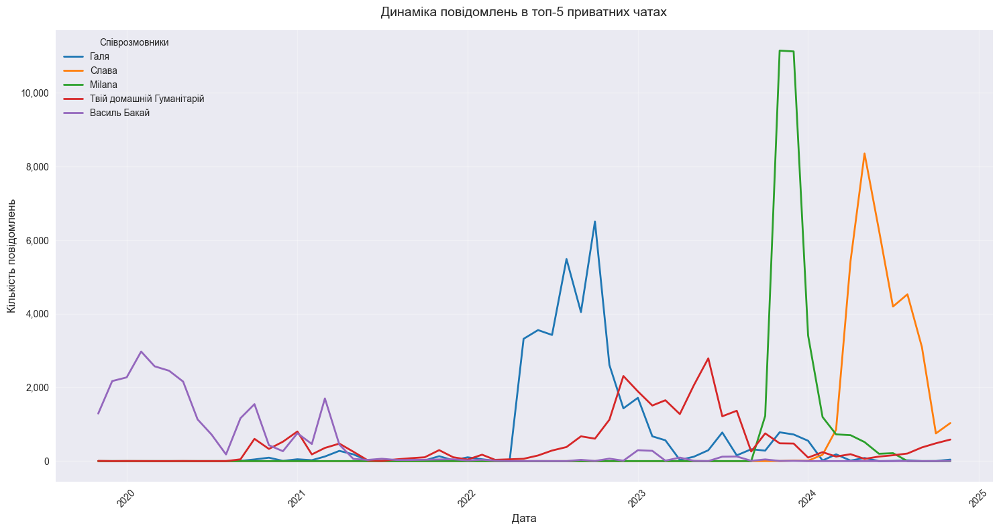

In [12]:
# Filter private dialogs and get top 5
private_dialogs = df_meta[df_meta['type'] == 'Private dialog']['dialog_id'].unique()
private_messages = df[df['dialog_id'].isin(private_dialogs)].copy()  # Create explicit copy

# Convert date to datetime and create year_month column
private_messages.loc[:, 'date'] = pd.to_datetime(private_messages['date'])
private_messages.loc[:, 'year_month'] = private_messages['date'].dt.strftime('%Y-%m')

# Get top 5 dialogs
top_5_dialogs = private_messages.groupby('dialog_id').size().sort_values(ascending=False).head(5)
top_5_ids = top_5_dialogs.index.tolist()

# Prepare data for each dialog
monthly_counts = []
chat_names = {}

for dialog_id in top_5_ids:
    # Get user name
    user_data = eval(df_meta[df_meta['dialog_id'] == dialog_id].iloc[0]['users'])
    user_name = user_data.get('first_name', 'Unknown')
    chat_names[dialog_id] = user_name
    
    # Get monthly counts
    dialog_messages = private_messages[private_messages['dialog_id'] == dialog_id]
    monthly = dialog_messages.groupby('year_month').size().reset_index()
    monthly.columns = ['year_month', 'count']
    monthly['dialog_id'] = dialog_id
    monthly_counts.append(monthly)

# Combine all monthly counts
all_monthly = pd.concat(monthly_counts, ignore_index=True)

# Pivot the data for plotting
pivoted_data = all_monthly.pivot(index='year_month', columns='dialog_id', values='count')
pivoted_data = pivoted_data.fillna(0)

# Convert index to datetime for better x-axis display
pivoted_data.index = pd.to_datetime(pivoted_data.index)

# Set style and create plot
plt.style.use('seaborn')
plt.figure(figsize=(15, 8))

# Plot each chat with different colors
colors = ['#1f77b4', '#ff7f0e', '#2ca02c', '#d62728', '#9467bd']
for idx, dialog_id in enumerate(top_5_ids):
    plt.plot(pivoted_data.index, pivoted_data[dialog_id], 
            label=chat_names[dialog_id], linewidth=2, color=colors[idx])

# Customize the plot
plt.title('Динаміка повідомлень в топ-5 приватних чатах', fontsize=14, pad=15)
plt.xlabel('Дата', fontsize=12)
plt.ylabel('Кількість повідомлень', fontsize=12)
plt.grid(True, alpha=0.3)
plt.legend(fontsize=10, title='Співрозмовники', loc='upper left')
plt.xticks(rotation=45)

# Format y-axis with thousand separator
plt.gca().yaxis.set_major_formatter(plt.FuncFormatter(lambda x, p: format(int(x), ',')))

# Adjust layout and display
plt.tight_layout()
plt.show()


C:\Users\Dmytro\AppData\Local\Temp\ipykernel_5652\3145773006.py:6: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  private_messages.loc[:, 'date'] = pd.to_datetime(private_messages['date'])


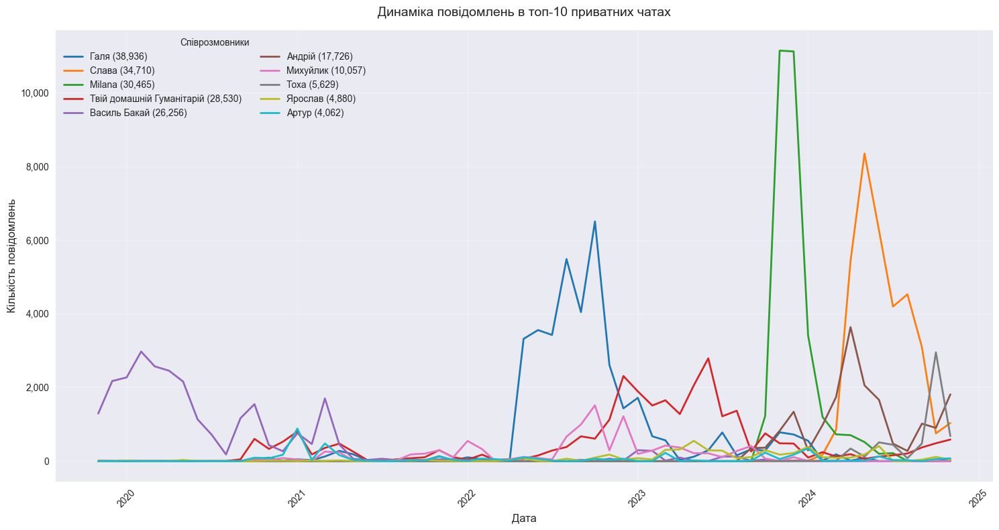

In [13]:
# Filter private dialogs and get top 10
private_dialogs = df_meta[df_meta['type'] == 'Private dialog']['dialog_id'].unique()
private_messages = df[df['dialog_id'].isin(private_dialogs)].copy()  # Create explicit copy

# Convert date to datetime and create year_month column using .loc
private_messages.loc[:, 'date'] = pd.to_datetime(private_messages['date'])
private_messages.loc[:, 'year_month'] = private_messages['date'].dt.strftime('%Y-%m')

# Get top 10 dialogs
top_10_dialogs = private_messages.groupby('dialog_id').size().sort_values(ascending=False).head(10)
top_10_ids = top_10_dialogs.index.tolist()

# Prepare data for each dialog
monthly_counts = []
chat_names = {}  # Store chat names for later use

for dialog_id in top_10_ids:
    # Get user name
    user_data = eval(df_meta[df_meta['dialog_id'] == dialog_id].iloc[0]['users'])
    user_name = user_data.get('first_name', 'Unknown')
    chat_names[dialog_id] = user_name
    
    # Get monthly counts
    dialog_messages = private_messages[private_messages['dialog_id'] == dialog_id]
    monthly = dialog_messages.groupby('year_month').size().reset_index()
    monthly.columns = ['year_month', 'count']
    monthly['dialog_id'] = dialog_id
    monthly_counts.append(monthly)

# Combine all data
all_monthly = pd.concat(monthly_counts, ignore_index=True)

# Pivot the data for plotting
pivoted_data = all_monthly.pivot(index='year_month', columns='dialog_id', values='count')
pivoted_data = pivoted_data.fillna(0)

# Convert index to datetime for better x-axis display
pivoted_data.index = pd.to_datetime(pivoted_data.index)

# Set style
plt.style.use('seaborn')
plt.figure(figsize=(15, 8))

# Define a colormap with 10 distinct colors
colors = ['#1f77b4', '#ff7f0e', '#2ca02c', '#d62728', '#9467bd', 
          '#8c564b', '#e377c2', '#7f7f7f', '#bcbd22', '#17becf']

# Plot each chat with different colors
for idx, dialog_id in enumerate(top_10_ids):
    plt.plot(pivoted_data.index, pivoted_data[dialog_id], 
            label=f"{chat_names[dialog_id]} ({int(top_10_dialogs[dialog_id]):,})", 
            linewidth=2, color=colors[idx])

# Customize the plot
plt.title('Динаміка повідомлень в топ-10 приватних чатах', fontsize=14, pad=15)
plt.xlabel('Дата', fontsize=12)
plt.ylabel('Кількість повідомлень', fontsize=12)
plt.grid(True, alpha=0.3)

# Create legend with two columns
plt.legend(fontsize=10, title='Співрозмовники', ncol=2, loc='upper left')

# Rotate x-axis labels
plt.xticks(rotation=45)

# Format y-axis with thousand separator
plt.gca().yaxis.set_major_formatter(plt.FuncFormatter(lambda x, p: format(int(x), ',')))

# Adjust layout to accommodate the legend
plt.tight_layout()

# Show plot
plt.show()

**Висновок**

Можна прослідкувати як з часом змінювалися ті, з ким я більше спілкуюся

### 2. Відсоток повідомлень в топ5 / 10 особистих чатах

**Вступ**

На лінійній діагармі видна кількісна характеристика того, з ким я спілкувався. Тому я використав діаграму, де можна прослідкувати відсоток того, з ким я більше спілкувався

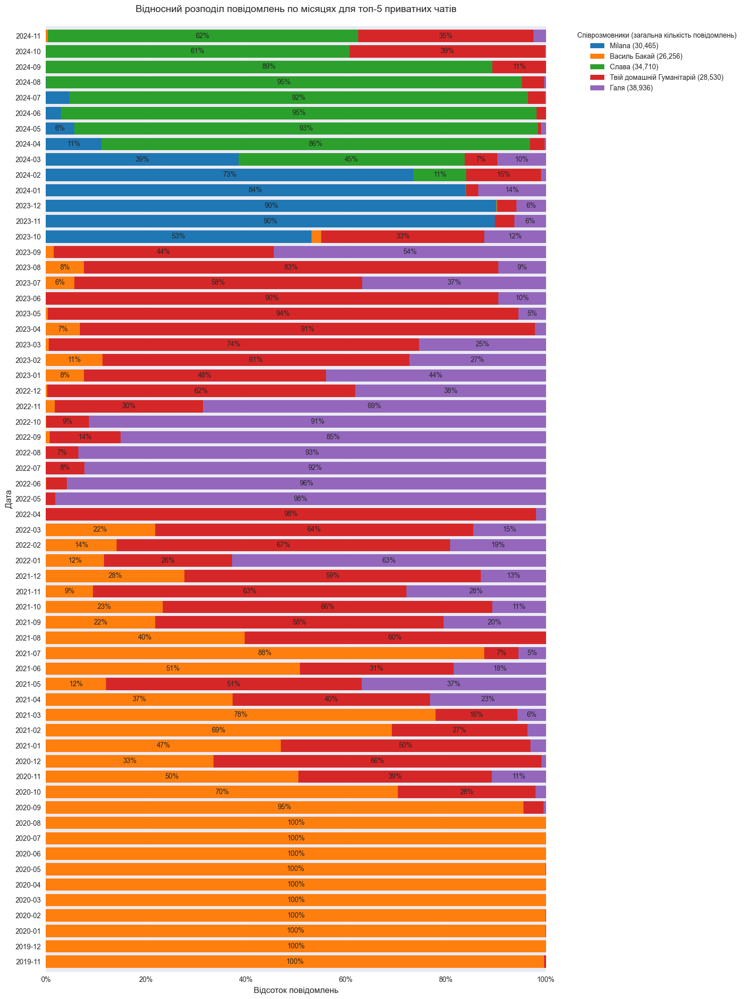

In [14]:
def create_horizontal_percentage_chart(df, df_meta, top_n=10, figsize=(15, 20)):
    # Filter private dialogs
    private_dialogs = df_meta[df_meta['type'] == 'Private dialog']['dialog_id'].unique()
    
    # Calculate total messages for private dialogs only
    private_messages_count = df[df['dialog_id'].isin(private_dialogs)].groupby('dialog_id').size()
    
    # Get top N dialogs based on message count
    top_n_dialogs = private_messages_count.sort_values(ascending=False).head(top_n)
    top_n_ids = top_n_dialogs.index.tolist()
    
    # Get messages for private dialogs
    private_messages = df[df['dialog_id'].isin(top_n_ids)].copy()
    
    # Convert date to datetime and handle timezone
    private_messages['date'] = pd.to_datetime(private_messages['date']).dt.tz_localize(None)
    private_messages['year_month'] = private_messages['date'].dt.strftime('%Y-%m')
    
    # Group by year_month and dialog_id
    monthly_counts = (private_messages.groupby(['year_month', 'dialog_id'])
                                    .size()
                                    .unstack(fill_value=0))
    
    # Sort index by date
    monthly_counts.index = pd.to_datetime(monthly_counts.index + '-01')
    monthly_counts = monthly_counts.sort_index()
    
    # Calculate percentages
    percentage_data = monthly_counts.div(monthly_counts.sum(axis=1), axis=0) * 100
    
    # Get chat names and counts
    chat_names = {}
    for dialog_id in percentage_data.columns:  # Використовуємо порядок з percentage_data
        user_data = eval(df_meta[df_meta['dialog_id'] == dialog_id].iloc[0]['users'])
        user_name = user_data.get('first_name', 'Unknown')
        chat_names[dialog_id] = {'name': user_name, 'count': private_messages_count[dialog_id]}
    
    # Plotting
    plt.style.use('seaborn')
    fig, ax = plt.subplots(figsize=figsize)
    
    # Define color scheme
    colors = ['#1f77b4', '#ff7f0e', '#2ca02c', '#d62728', '#9467bd'][:top_n]
    
    # Create horizontal stacked bar chart
    percentage_data.plot(kind='barh', stacked=True, color=colors, width=0.8, ax=ax)
    
    # Add percentage labels for segments > 5%
    for c in ax.containers:
        labels = [f'{v:.0f}%' if v >= 5 else '' for v in c.datavalues]
        ax.bar_label(c, labels=labels, label_type='center')
    
    # Format axes
    plt.xlabel('Відсоток повідомлень', fontsize=12)
    plt.ylabel('Дата', fontsize=12)
    plt.yticks(range(len(percentage_data.index)), 
              [d.strftime('%Y-%m') for d in monthly_counts.index], 
              rotation=0)
    
    plt.grid(True, axis='x', alpha=0.3)
    plt.gca().xaxis.set_major_formatter(plt.FuncFormatter(lambda x, p: f'{int(x)}%'))
    plt.xlim(0, 100)
    
    # Create legend with correct order and message counts
    legend_labels = [f"{chat_names[col]['name']} ({int(chat_names[col]['count']):,})" 
                    for col in percentage_data.columns]
    
    plt.legend(legend_labels,
              title='Співрозмовники (загальна кількість повідомлень)',
              bbox_to_anchor=(1.05, 1),
              loc='upper left',
              ncol=1)
    
    plt.title(f'Відносний розподіл повідомлень по місяцях для топ-{top_n} приватних чатів',
             pad=20, fontsize=14)
    
    plt.tight_layout()
    
    return plt.gcf()

# Create and display the plot
fig = create_horizontal_percentage_chart(df, df_meta, top_n=5)
plt.show()

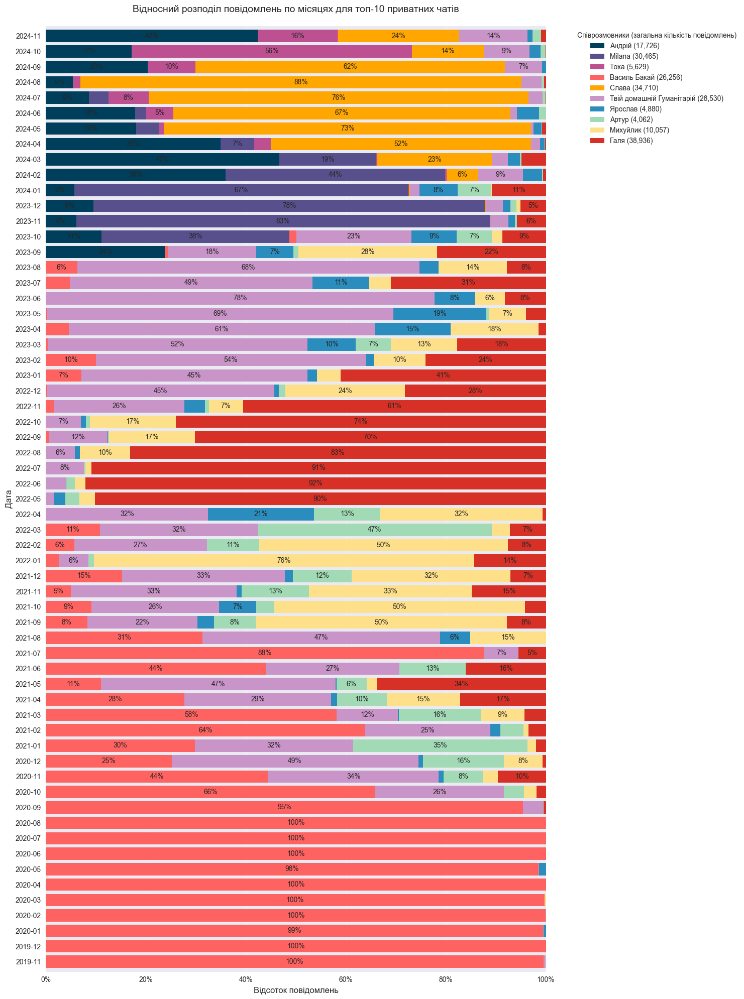

In [15]:
def create_horizontal_percentage_chart(df, df_meta, top_n=10, figsize=(15, 20)):
    # Filter private dialogs
    private_dialogs = df_meta[df_meta['type'] == 'Private dialog']['dialog_id'].unique()
    
    # Calculate total messages for private dialogs only
    private_messages_count = df[df['dialog_id'].isin(private_dialogs)].groupby('dialog_id').size()
    
    # Get top N dialogs based on message count
    top_n_dialogs = private_messages_count.sort_values(ascending=False).head(top_n)
    top_n_ids = top_n_dialogs.index.tolist()
    
    # Get messages for private dialogs
    private_messages = df[df['dialog_id'].isin(top_n_ids)].copy()
    
    # Convert date to datetime and handle timezone
    private_messages['date'] = pd.to_datetime(private_messages['date']).dt.tz_localize(None)
    private_messages['year_month'] = private_messages['date'].dt.strftime('%Y-%m')
    
    # Group by year_month and dialog_id
    monthly_counts = (private_messages.groupby(['year_month', 'dialog_id'])
                                    .size()
                                    .unstack(fill_value=0))
    
    # Sort index by date
    monthly_counts.index = pd.to_datetime(monthly_counts.index + '-01')
    monthly_counts = monthly_counts.sort_index()
    
    # Calculate percentages
    percentage_data = monthly_counts.div(monthly_counts.sum(axis=1), axis=0) * 100
    
    # Get chat names and counts
    chat_names = {}
    for dialog_id in percentage_data.columns:  # Використовуємо порядок з percentage_data
        user_data = eval(df_meta[df_meta['dialog_id'] == dialog_id].iloc[0]['users'])
        user_name = user_data.get('first_name', 'Unknown')
        chat_names[dialog_id] = {'name': user_name, 'count': private_messages_count[dialog_id]}
    
    # Plotting
    plt.style.use('seaborn')
    fig, ax = plt.subplots(figsize=figsize)
    
    # Define color scheme
    colors = [
        '#003f5c',  # Темно-синій
        '#58508d',  # Фіолетово-синій
        '#bc5090',  # Яскраво-рожевий
        '#ff6361',  # Червонувато-кораловий
        '#ffa600',  # Яскраво-помаранчевий
        '#c994c7',  # Світло фіолетовий
        '#2b8cbe',  # Блакитний
        '#a1dab4',  # Світло-зелений
        '#fee08b',  # Світло-жовтий
        '#d73027'   # Яскраво-червоний
    ][:top_n]
    
    # Create horizontal stacked bar chart
    percentage_data.plot(kind='barh', stacked=True, color=colors, width=0.8, ax=ax)
    
    # Add percentage labels for segments > 5%
    for c in ax.containers:
        labels = [f'{v:.0f}%' if v >= 5 else '' for v in c.datavalues]
        ax.bar_label(c, labels=labels, label_type='center')
    
    # Format axes
    plt.xlabel('Відсоток повідомлень', fontsize=12)
    plt.ylabel('Дата', fontsize=12)
    plt.yticks(range(len(percentage_data.index)), 
              [d.strftime('%Y-%m') for d in monthly_counts.index], 
              rotation=0)
    
    plt.grid(True, axis='x', alpha=0.3)
    plt.gca().xaxis.set_major_formatter(plt.FuncFormatter(lambda x, p: f'{int(x)}%'))
    plt.xlim(0, 100)
    
    # Create legend with correct order and message counts
    legend_labels = [f"{chat_names[col]['name']} ({int(chat_names[col]['count']):,})" 
                    for col in percentage_data.columns]
    
    plt.legend(legend_labels,
              title='Співрозмовники (загальна кількість повідомлень)',
              bbox_to_anchor=(1.05, 1),
              loc='upper left',
              ncol=1)
    
    plt.title(f'Відносний розподіл повідомлень по місяцях для топ-{top_n} приватних чатів',
             pad=20, fontsize=14)
    
    plt.tight_layout()
    
    return plt.gcf()

# Create and display the plot
fig = create_horizontal_percentage_chart(df, df_meta, top_n=10)
plt.show()

**Висновок**

Ще одна демонстрація у відсотковому плані, з ким я переважно спілкувався кожного місяця

### 3. Динаміка повідомлень які я пишу в особисті та в групи

**Вступ**

Цікаво прослідкувати динаміку того, де я більше спілкуюся - в особистих чи групових чатах.

C:\Users\Dmytro\AppData\Local\Temp\ipykernel_5652\2857701134.py:5: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  messages.loc[:, 'date'] = pd.to_datetime(messages['date'])



Статистика повідомлень:
Загальна кількість повідомлень: 157,469
В особистих чатах: 107,476 (68.3%)
В групових чатах: 49,993 (31.7%)


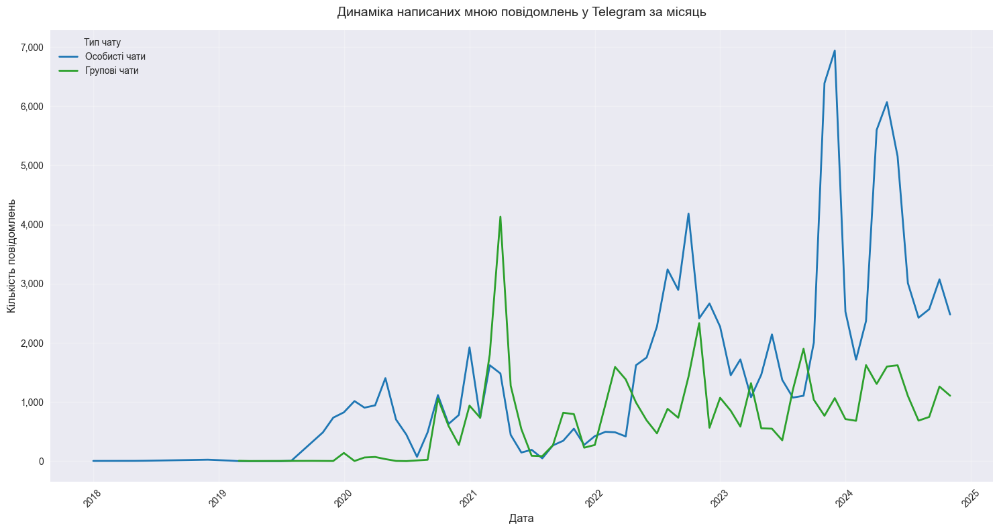

In [16]:
# Create a copy of the messages dataframe
messages = df.copy()

# Convert date to datetime
messages.loc[:, 'date'] = pd.to_datetime(messages['date'])
messages.loc[:, 'year_month'] = messages['date'].dt.strftime('%Y-%m')

# Filter messages sent by the user
my_id = 'PeerUser(user_id=519270613)'
user_messages = messages[messages['from_id'] == my_id]

# Separate private and group chats
private_dialogs = df_meta[df_meta['type'] == 'Private dialog']['dialog_id'].unique()
group_dialogs = df_meta[df_meta['type'] != 'Private dialog']['dialog_id'].unique()

# Get message counts for both types
private_messages = user_messages[user_messages['dialog_id'].isin(private_dialogs)]
group_messages = user_messages[user_messages['dialog_id'].isin(group_dialogs)]

# Calculate monthly counts
private_monthly = private_messages.groupby('year_month').size()
group_monthly = group_messages.groupby('year_month').size()

# Calculate total statistics
total_private = private_messages.shape[0]
total_group = group_messages.shape[0]
total_messages = total_private + total_group

# Create the visualization
plt.style.use('seaborn')
plt.figure(figsize=(15, 8))

# Plot both lines
plt.plot(pd.to_datetime(private_monthly.index), private_monthly.values, 
        label='Особисті чати', linewidth=2, color='#1f77b4')
plt.plot(pd.to_datetime(group_monthly.index), group_monthly.values, 
        label='Групові чати', linewidth=2, color='#2ca02c')

# Customize the plot
plt.title('Динаміка написаних мною повідомлень у Telegram за місяць', fontsize=14, pad=15)
plt.xlabel('Дата', fontsize=12)
plt.ylabel('Кількість повідомлень', fontsize=12)
plt.grid(True, alpha=0.3)

# Add legend
plt.legend(fontsize=10, title='Тип чату', loc='upper left')

# Rotate x-axis labels
plt.xticks(rotation=45)

# Format y-axis with thousand separator
plt.gca().yaxis.set_major_formatter(plt.FuncFormatter(lambda x, p: format(int(x), ',')))

# Adjust layout
plt.tight_layout()

# Print statistics
print("\nСтатистика повідомлень:")
print(f"Загальна кількість повідомлень: {total_messages:,}")
print(f"В особистих чатах: {total_private:,} ({total_private/total_messages*100:.1f}%)")
print(f"В групових чатах: {total_group:,} ({total_group/total_messages*100:.1f}%)")

# Show plot
plt.show()

**Висновок**

Видно, що з часом я більше почав писати в особистих повідомленнях

### 4. Розподіл днів, коли я написав найбільшу кількість повідомлень

**Вступ**

Мета - виявити дні, коли я найбільеш писав повідомлень

In [17]:
def analyze_top_message_days(df, my_id, n=50):
    # Convert date to datetime
    df.loc[:, 'date'] = pd.to_datetime(df['date'])
    
    # Create date column without time
    df.loc[:, 'day'] = df['date'].dt.date
    
    # Filter messages where from_id matches my_id
    my_messages = df[df['from_id'] == my_id].copy()
    
    # Group by day and count messages
    daily_counts = my_messages.groupby('day').size().reset_index()
    daily_counts.columns = ['day', 'message_count']
    
    # Sort by message count and get top n days
    top_days = daily_counts.nlargest(n, 'message_count')

    # Print top 5 days
    print(f"\nТоп {n//10} днів за кількістю повідомлень:")
    print("-" * 50)
    for idx, row in top_days.head(n//10).iterrows():
        print(f"{row['day'].strftime('%d %B %Y')}: {row['message_count']:,} повідомлень")
    print("-" * 50)
    
    # Create scatter plot
    plt.style.use('seaborn')
    plt.figure(figsize=(15, 8))
    
    # Create scatter plot with gradient color based on message count
    scatter = plt.scatter(top_days['day'], 
                         top_days['message_count'],
                         c=top_days['message_count'],
                         cmap='viridis',
                         s=100,
                         alpha=0.6)
    
    # Add color bar
    plt.colorbar(scatter, label='Кількість повідомлень')
    
    # Customize the plot
    plt.title(f'Топ {n} днів за кількістю надісланих повідомлень', fontsize=14, pad=15)
    plt.xlabel('Дата', fontsize=12)
    plt.ylabel('Кількість повідомлень', fontsize=12)
    plt.grid(True, alpha=0.3)
    
    # Rotate x-axis labels
    plt.xticks(rotation=45)
    
    # Format y-axis with thousand separator
    plt.gca().yaxis.set_major_formatter(plt.FuncFormatter(lambda x, p: format(int(x), ',')))
    
    # Add annotations for top 5 days
    top_5_days = top_days.head()
    for _, row in top_5_days.iterrows():
        plt.annotate(f"{row['message_count']}",
                    (row['day'], row['message_count']),
                    xytext=(10, 10),
                    textcoords='offset points',
                    fontsize=10,
                    bbox=dict(facecolor='white', edgecolor='none', alpha=0.7))
    
    plt.tight_layout()
    return plt.gcf()

C:\Users\Dmytro\AppData\Local\Temp\ipykernel_5652\1766229449.py:3: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  df.loc[:, 'date'] = pd.to_datetime(df['date'])



Топ 5 днів за кількістю повідомлень:
--------------------------------------------------
27 November 2023: 593 повідомлень
14 December 2023: 562 повідомлень
01 June 2024: 552 повідомлень
26 April 2024: 524 повідомлень
15 June 2024: 524 повідомлень
--------------------------------------------------


C:\Users\Dmytro\AppData\Local\Temp\ipykernel_5652\1766229449.py:38: MatplotlibDeprecationWarning: Auto-removal of grids by pcolor() and pcolormesh() is deprecated since 3.5 and will be removed two minor releases later; please call grid(False) first.
  plt.colorbar(scatter, label='Кількість повідомлень')


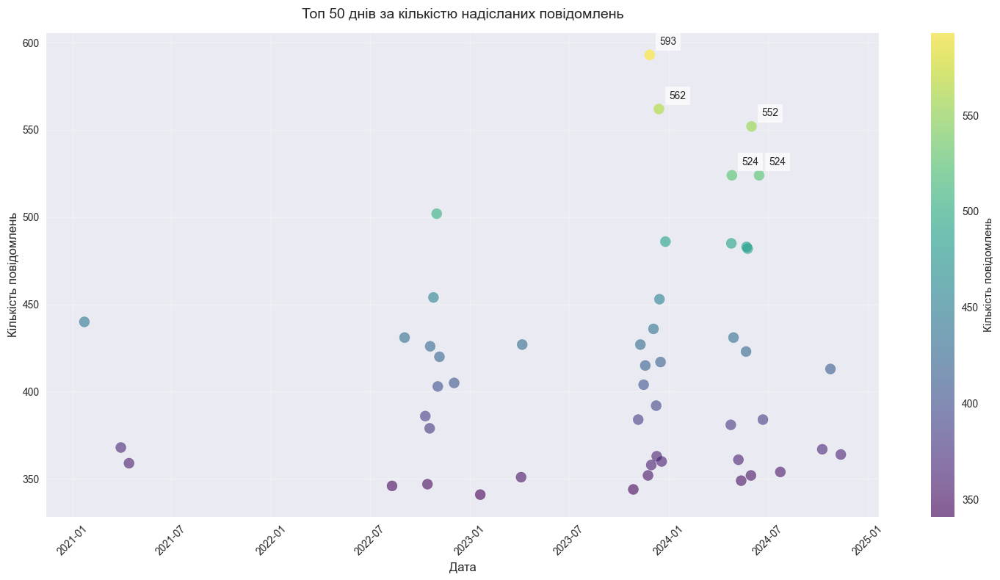

In [18]:
my_id = 'PeerUser(user_id=519270613)'
fig = analyze_top_message_days(df, my_id, n=50)
plt.show()

C:\Users\Dmytro\AppData\Local\Temp\ipykernel_5652\1766229449.py:3: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  df.loc[:, 'date'] = pd.to_datetime(df['date'])



Топ 10 днів за кількістю повідомлень:
--------------------------------------------------
27 November 2023: 593 повідомлень
14 December 2023: 562 повідомлень
01 June 2024: 552 повідомлень
26 April 2024: 524 повідомлень
15 June 2024: 524 повідомлень
01 November 2022: 502 повідомлень
26 December 2023: 486 повідомлень
25 April 2024: 485 повідомлень
23 May 2024: 483 повідомлень
25 May 2024: 482 повідомлень
--------------------------------------------------


C:\Users\Dmytro\AppData\Local\Temp\ipykernel_5652\1766229449.py:38: MatplotlibDeprecationWarning: Auto-removal of grids by pcolor() and pcolormesh() is deprecated since 3.5 and will be removed two minor releases later; please call grid(False) first.
  plt.colorbar(scatter, label='Кількість повідомлень')


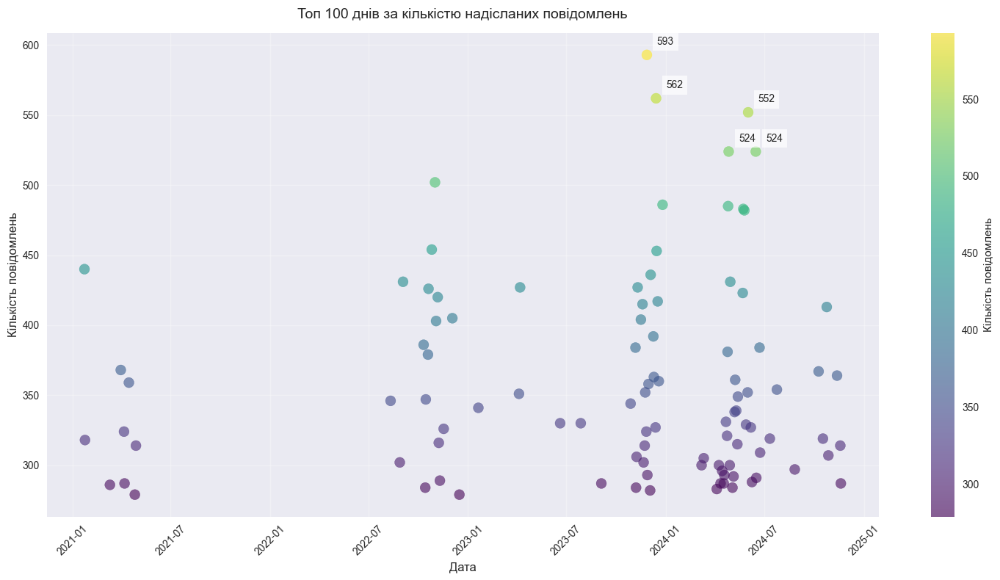

In [19]:
my_id = 'PeerUser(user_id=519270613)'
fig = analyze_top_message_days(df, my_id, n=100)
plt.show()

**Висновок**

З візуалізацій можна помітити, що це переважно тенденція, що я багато пишу в телеграм (якщо дивитись на сусідні дні). Тому це скоріше доволі закономірна, а не анаомальна активність

### 5. Кількість використаних мною реакцій

**Вступ**

У цьому запитанні візуалізується графік того, скільки я використовую певні реації

**Зауваження:** графік через бібліотеку matplotlib не може відобразити емоції. Тому я зробив додаткову діаграму використовуючи plotly

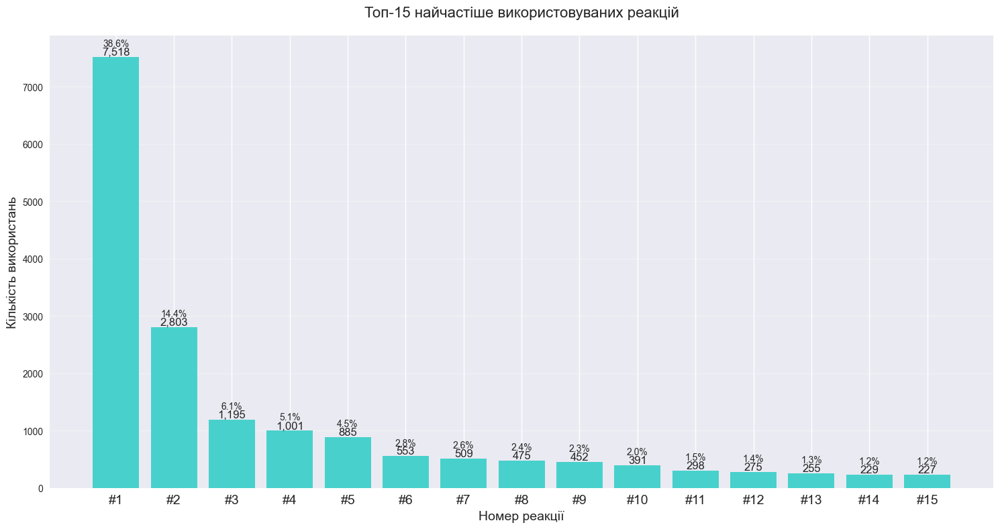


Загальна статистика:
Загальна кількість реакцій: 19,465
Унікальних реакцій: 66
Середня кількість використань однієї реакції: 294.9

Детальна статистика топ-15 реакцій:

Номер | Реакція | Кількість | % від загальної
----------------------------------------------------------
# 1 |    ❤    |   7,518   |     38.6    %
# 2 |    😭    |   2,803   |     14.4    %
# 3 |    😁    |   1,195   |     6.1     %
# 4 |    🫡    |   1,001   |     5.1     %
# 5 |    🤝    |    885    |     4.5     %
# 6 |    😨    |    553    |     2.8     %
# 7 |    🥰    |    509    |     2.6     %
# 8 |    👍    |    475    |     2.4     %
# 9 |    👾    |    452    |     2.3     %
#10 |   ❤‍🔥   |    391    |     2.0     %
#11 |    💔    |    298    |     1.5     %
#12 |    🔥    |    275    |     1.4     %
#13 |    😢    |    255    |     1.3     %
#14 |    🤯    |    229    |     1.2     %
#15 |    😈    |    227    |     1.2     %


In [72]:
def analyze_total_reactions(df, user_id):
    """
    Аналізує всі використані реакції конкретним користувачем
    """
    reaction_counts = Counter()
    
    non_empty_reactions = df[df['reactions'].apply(lambda x: isinstance(x, str) and x != '{}')]
    
    for reactions_str in non_empty_reactions['reactions']:
        try:
            reactions_dict = ast.literal_eval(reactions_str)
            for user, reaction in reactions_dict.items():
                if str(user) == "519270613":
                    reaction_counts[reaction] += 1
        except:
            continue
    
    return dict(reaction_counts)

# Налаштування стилю
plt.style.use('seaborn')
plt.figure(figsize=(15, 8))

# Отримуємо дані
reaction_data = analyze_total_reactions(df, "519270613")
reaction_data = dict(sorted(reaction_data.items(), key=lambda x: x[1], reverse=True))
top_reactions = dict(list(reaction_data.items())[:15])

# Створюємо відповідність між емодзі та номерами
emoji_to_number = {emoji: f"#{i+1}" for i, emoji in enumerate(top_reactions.keys())}
number_to_emoji = {v: k for k, v in emoji_to_number.items()}

# Створюємо графік з однаковим кольором для всіх стовпців
bars = plt.bar(range(len(top_reactions)), top_reactions.values(), color='#48D1CC')

# Налаштовуємо вигляд графіка
plt.title('Топ-15 найчастіше використовуваних реакцій', fontsize=16, pad=20)
plt.xlabel('Номер реакції', fontsize=14)
plt.ylabel('Кількість використань', fontsize=14)

# Додаємо підписи значень над стовпчиками
total_reactions = sum(reaction_data.values())
for idx, bar in enumerate(bars):
    height = bar.get_height()
    
    # Додаємо кількість використань
    plt.text(bar.get_x() + bar.get_width()/2., height,
             f'{int(height):,}',
             ha='center', va='bottom',
             fontsize=12)
    
    # Додаємо відсотки
    percentage = (height / total_reactions) * 100
    plt.text(bar.get_x() + bar.get_width()/2., height + (max(top_reactions.values()) * 0.02),
             f'{percentage:.1f}%',
             ha='center', va='bottom',
             fontsize=10)

# Використовуємо номери замість емодзі на осі X
plt.xticks(range(len(top_reactions)), [f"#{i+1}" for i in range(len(top_reactions))], rotation=0, fontsize=14)
plt.grid(True, alpha=0.3, axis='y')

# Регулюємо відступи
plt.tight_layout()

# Виводимо графік
plt.show()

# Виводимо загальну статистику
print(f"\nЗагальна статистика:")
print(f"Загальна кількість реакцій: {total_reactions:,}")
print(f"Унікальних реакцій: {len(reaction_data):,}")
print(f"Середня кількість використань однієї реакції: {total_reactions/len(reaction_data):.1f}")

# Виводимо детальну статистику топ-15 з відповідністю номерів та емодзі
print("\nДетальна статистика топ-15 реакцій:")
print("\nНомер | Реакція | Кількість | % від загальної")
print("-" * 58)
for i, (reaction, count) in enumerate(top_reactions.items(), 1):
    percentage = (count / total_reactions) * 100
    print(f"#{i:2d} | {reaction:^7} | {count:^9,d} | {percentage:^12.1f}%")

In [21]:
def analyze_total_reactions(df, user_id):
    """
    Аналізує всі використані реакції конкретним користувачем
    """
    reaction_counts = Counter()
    
    # Фільтруємо записи, де є реакції
    non_empty_reactions = df[df['reactions'].apply(lambda x: isinstance(x, str) and x != '{}')]
    
    for reactions_str in non_empty_reactions['reactions']:
        try:
            reactions_dict = ast.literal_eval(reactions_str)  # Конвертуємо рядок у словник
            for user, reaction in reactions_dict.items():
                if str(user) == user_id:  # Перевіряємо, чи реакція від потрібного користувача
                    reaction_counts[reaction] += 1
        except:
            continue
    
    return dict(reaction_counts)

# Аналіз даних
reaction_data = analyze_total_reactions(df, "519270613")

# Сортуємо реакції за частотою використання та залишаємо топ-15
reaction_data = dict(sorted(reaction_data.items(), key=lambda x: x[1], reverse=True))
top_reactions = dict(list(reaction_data.items())[:15])

# Підготовка даних для побудови графіка
total_reactions = sum(reaction_data.values())
reaction_df = pd.DataFrame({
    'Реакція': list(top_reactions.keys()),
    'Кількість': list(top_reactions.values()),
    '% від загальної': [count / total_reactions * 100 for count in top_reactions.values()]
})

# Об'єднання тексту для підписів
reaction_df['Підпис'] = reaction_df['Кількість'].map('{:,}'.format) + '<br>' + \
                        reaction_df['% від загальної'].map('{:.1f}%'.format)

# Додаємо кольори для кожного стовпця
colors = px.colors.qualitative.Pastel  # Використання пастельної палітри

# Якщо кольорів менше, ніж реакцій, розширюємо список
expanded_colors = colors * (len(reaction_df) // len(colors) + 1)
reaction_df['Колір'] = expanded_colors[:len(reaction_df)]  # Призначення кольорів

# Створення графіка
fig = px.bar(
    reaction_df,
    x='Реакція',
    y='Кількість',
    text='Підпис',
    color='Реакція',  # Кожна реакція отримає свій колір
    color_discrete_sequence=reaction_df['Колір'],  # Передаємо кольори
    title='Топ-15 найчастіше використовуваних реакцій',
    labels={'Реакція': 'Емодзі', 'Кількість': 'Кількість використань'},
    template='seaborn'
)

# Оновлення підписів стовпчиків
fig.update_traces(
    textposition='outside',  # Підпис розташований поза стовпчиком
    texttemplate='%{text}',  # Форматування тексту: кількість + відсоток
    marker_line_width=0.8,   # Тонкі краї стовпчиків
    marker_line_color="black"  # Чорні краї стовпчиків
)

# Налаштування висоти вісі Y, ширини стовпчиків і верхнього відступу
fig.update_layout(
    xaxis_title='Реакція (Емодзі)',
    yaxis_title='Кількість використань',
    title_x=0.5,
    bargap=0.3,  # Регулює ширину стовпчиків
    height=700,  # Робимо графік вищим
    margin=dict(l=40, r=40, t=80, b=40),  # Збільшуємо верхній відступ
    yaxis=dict(range=[0, max(reaction_df['Кількість']) * 1.15])  # Додаємо місце для підписів
)

# Показуємо графік
fig.show()


**Висновок**

Найпопулярніша реакція сердечка стоїть за замовчуванням, тому вона й найчастіше використовується (і є універсальною). Інші реакції відображають основні емоції, хоча іноді набувають свого значення.

### 6. Частота найбільш вживаних реакцій

**Вступ**

Хотілося б побачити не лише кілкьість використання реацій, а й динаміку їх використання з часом. 

In [22]:
def analyze_monthly_reactions(df, user_id='519270613'):
    # Створюємо словник для зберігання реакцій по місяцях
    monthly_reactions = defaultdict(lambda: defaultdict(int))
    
    # Конвертуємо дату в datetime якщо вона ще не в цьому форматі
    if not pd.api.types.is_datetime64_any_dtype(df['date']):
        df['date'] = pd.to_datetime(df['date'])
    
    # Проходимо по кожному рядку з реакціями
    for date, reactions_str in zip(df['date'], df['reactions']):
        if pd.isna(reactions_str):
            continue
            
        try:
            # Парсимо словник реакцій
            reactions_dict = ast.literal_eval(reactions_str)
            
            # Отримуємо місяць і рік
            month_key = date.strftime('%Y-%m')
            
            # Шукаємо реакції користувача
            for user, reaction in reactions_dict.items():
                if str(user) == user_id:
                    monthly_reactions[month_key][reaction] += 1
                    
        except (ValueError, SyntaxError):
            continue
    
    # Конвертуємо в DataFrame для зручної обробки
    monthly_data = []
    for month, reactions in monthly_reactions.items():
        for reaction, count in reactions.items():
            monthly_data.append({
                'month': month,
                'reaction': reaction,
                'count': count
            })
    
    results_df = pd.DataFrame(monthly_data)
    
    # Створюємо зведену таблицю
    pivot_df = results_df.pivot(
        index='month',
        columns='reaction',
        values='count'
    ).fillna(0)
    
    # Сортуємо за датою
    pivot_df.sort_index(inplace=True)
    
    return pivot_df, results_df

def emoji_to_label(emoji):
    # Словник для конвертації емодзі в текстові мітки
    emoji_map = {
        '❤': 'heart',
        '👍': 'thumbs_up',
        '😭': 'crying',
        '😁': 'grinning',
        '🫡': 'saluting',
        '🤝': 'handshake',
        '🤩': 'star_struck'
    }
    return emoji_map.get(emoji, emoji)


def analyze_trends(pivot_df):
    # Конвертуємо індекс в datetime
    pivot_df.index = pd.to_datetime(pivot_df.index + '-01')
    
    # Аналіз трендів використання реакцій
    monthly_totals = pivot_df.sum(axis=1)
    peak_months = monthly_totals.nlargest(3)
    
    # Розраховуємо квартальні середні
    quarterly_avg = monthly_totals.resample('Q').mean()
    
    # Знаходимо періоди зростання/спадання
    growth_periods = []
    current_trend = None
    trend_start = None
    
    for i in range(1, len(monthly_totals)):
        if monthly_totals.iloc[i] > monthly_totals.iloc[i-1] * 1.5:  # значне зростання
            if current_trend != 'growth':
                if current_trend:
                    growth_periods.append((trend_start, monthly_totals.index[i-1], current_trend))
                trend_start = monthly_totals.index[i]
                current_trend = 'growth'
        elif monthly_totals.iloc[i] < monthly_totals.iloc[i-1] * 0.67:  # значний спад
            if current_trend != 'decline':
                if current_trend:
                    growth_periods.append((trend_start, monthly_totals.index[i-1], current_trend))
                trend_start = monthly_totals.index[i]
                current_trend = 'decline'
    
    # Повертаємо індекс до оригінального формату для сумісності
    pivot_df.index = pivot_df.index.strftime('%Y-%m')
    
    return {
        'peak_months': peak_months,
        'quarterly_avg': quarterly_avg,
        'growth_periods': growth_periods
    }

def generate_extended_summary(pivot_df):
    # Розширений аналіз даних
    trends = analyze_trends(pivot_df)
    
    summary = {
        'total_reactions': int(pivot_df.sum().sum()),
        'peak_months': trends['peak_months'],
        'quarterly_avg': trends['quarterly_avg'],
        'growth_periods': trends['growth_periods'],
        'unique_reactions_count': len(pivot_df.columns),
        'most_diverse_month': pivot_df.astype(bool).sum(axis=1).idxmax(),
        'least_diverse_month': pivot_df.astype(bool).sum(axis=1).idxmin(),
    }
    
    return summary

In [23]:
def plot_enhanced_monthly_reactions(pivot_df, top_n=5):
    # Створюємо графік
    plt.style.use('seaborn')
    fig, (ax1, ax2) = plt.subplots(2, 1, figsize=(15, 12))
    
    # Конвертуємо емодзі в текстові мітки для графіка
    pivot_df_labeled = pivot_df.rename(columns=emoji_to_label)
    
    # Графік топ реакцій
    total_by_reaction = pivot_df_labeled.sum()
    top_reactions = total_by_reaction.nlargest(top_n)
    
    for reaction in top_reactions.index:
        ax1.plot(pivot_df_labeled.index, pivot_df_labeled[reaction], 
                marker='o', label=reaction, linewidth=2)
    
    ax1.set_title('Top 5 реакцій по місяцях')
    ax1.set_xlabel('Місяць')
    ax1.set_ylabel('Кількість реакцій')
    ax1.tick_params(axis='x', rotation=45)
    ax1.legend(title='Реакції')
    ax1.grid(True, linestyle='--', alpha=0.7)
    
    # Графік загальної кількості реакцій
    total_monthly = pivot_df_labeled.sum(axis=1)
    ax2.bar(pivot_df_labeled.index, total_monthly, alpha=0.7)
    ax2.set_title('Загальна кількість реакцій по місяцях')
    ax2.set_xlabel('Місяць')
    ax2.set_ylabel('Кількість реакцій')
    ax2.tick_params(axis='x', rotation=45)
    
    plt.tight_layout()
    return fig

def print_analysis_report(summary):
    print("=== Аналіз використання реакцій ===\n")
    
    print("Піки активності:")
    for date, count in summary['peak_months'].items():
        print(f"- {date.strftime('%Y-%m') if hasattr(date, 'strftime') else date}: {int(count)} реакцій")
    
    print("\nСередня кількість реакцій по кварталах:")
    for date, count in summary['quarterly_avg'].items():
        year = date.year
        quarter = (date.month - 1) // 3 + 1
        print(f"- {year}-Q{quarter}: {int(count)} реакцій")
    
    print("\nПеріоди значних змін:")
    for start, end, trend_type in summary['growth_periods']:
        trend_text = "зростання" if trend_type == "growth" else "спадання"
        start_str = start.strftime('%Y-%m') if hasattr(start, 'strftime') else start
        end_str = end.strftime('%Y-%m') if hasattr(end, 'strftime') else end
        print(f"- {start_str} - {end_str}: період {trend_text}")
    
    print(f"\nРізноманітність реакцій:")
    print(f"- Всього унікальних реакцій: {summary['unique_reactions_count']}")
    print(f"- Місяць з найбільшою різноманітністю: {summary['most_diverse_month']}")
    print(f"- Місяць з найменшою різноманітністю: {summary['least_diverse_month']}")

=== Аналіз використання реакцій ===

Піки активності:
- 2024-05: 2492 реакцій
- 2024-06: 2223 реакцій
- 2023-12: 1342 реакцій

Середня кількість реакцій по кварталах:
- 2021-Q4: 6 реакцій
- 2022-Q1: 34 реакцій
- 2022-Q2: 33 реакцій
- 2022-Q3: 409 реакцій
- 2022-Q4: 437 реакцій
- 2023-Q1: 235 реакцій
- 2023-Q2: 127 реакцій
- 2023-Q3: 330 реакцій
- 2023-Q4: 945 реакцій
- 2024-Q1: 446 реакцій
- 2024-Q2: 1960 реакцій
- 2024-Q3: 1087 реакцій
- 2024-Q4: 660 реакцій

Періоди значних змін:
- 2022-01 - 2022-01: період спадання
- 2022-02 - 2022-03: період зростання
- 2022-04 - 2022-04: період спадання
- 2022-05 - 2022-10: період зростання
- 2022-11 - 2022-12: період спадання
- 2023-01 - 2023-01: період зростання
- 2023-02 - 2023-04: період спадання
- 2023-05 - 2023-12: період зростання
- 2024-01 - 2024-03: період спадання
- 2024-04 - 2024-06: період зростання

Різноманітність реакцій:
- Всього унікальних реакцій: 66
- Місяць з найбільшою різноманітністю: 2023-11
- Місяць з найменшою різноманітні

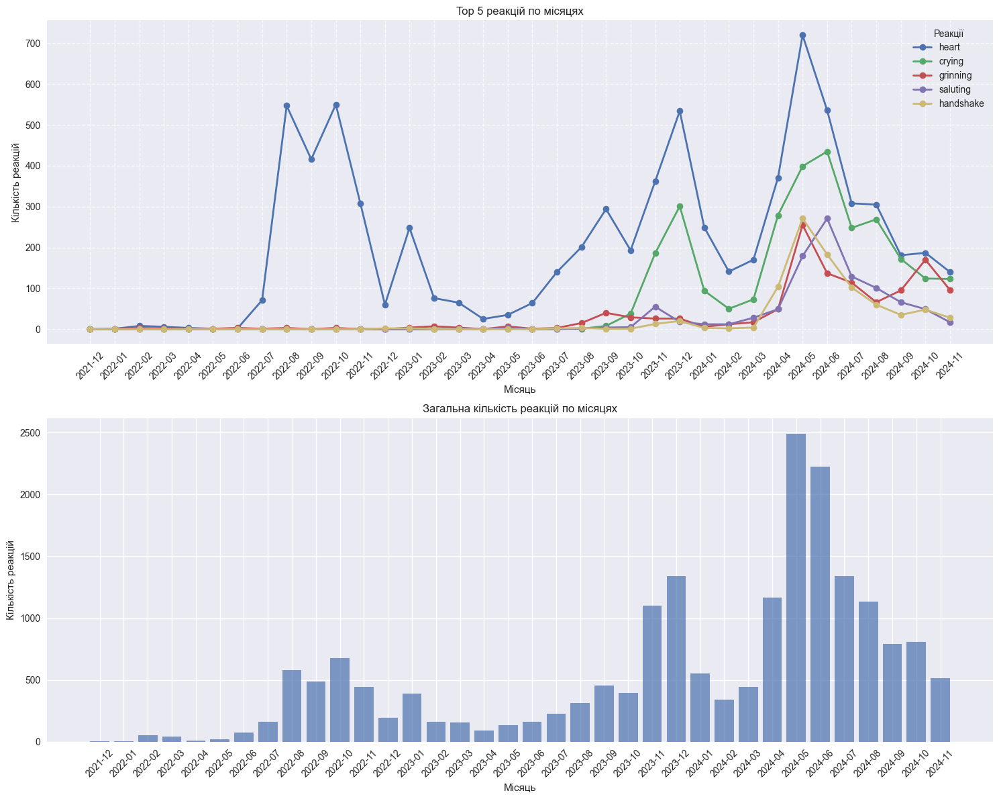

In [24]:
# Створення основних даних
pivot_df, results_df = analyze_monthly_reactions(df)

# Створення графіків
plot_enhanced_monthly_reactions(pivot_df)

# Отримання розширеного аналізу
summary = generate_extended_summary(pivot_df)
print_analysis_report(summary)

**Висновок**

Можна прослідкувати як з часом я використовую різні реакції. Також переважно на графіку загальна тенденція, що не залежить від конкретної реакції

### 7. Мої повідомлення з найбільшою кількістю реакцій

**Вступ**

Цікаво побачити які з моїх повідомлень забрали найбільшку кількість реакцій

In [25]:
def analyze_message_reactions(df, user_id='PeerUser(user_id=519270613)'):
    # Фільтруємо повідомлення конкретного користувача
    user_messages = df[df['from_id'] == user_id].copy()
    
    # Функція для підрахунку кількості реакцій
    def count_reactions(reactions_str):
        if pd.isna(reactions_str):
            return 0
        try:
            reactions_dict = ast.literal_eval(reactions_str)
            return len(reactions_dict)
        except:
            return 0
    
    # Додаємо колонку з кількістю реакцій
    user_messages['reaction_count'] = user_messages['reactions'].apply(count_reactions)
    
    # Функція для отримання списку реакцій
    def get_reaction_list(reactions_str):
        if pd.isna(reactions_str):
            return []
        try:
            reactions_dict = ast.literal_eval(reactions_str)
            return list(reactions_dict.values())
        except:
            return []
    
    # Додаємо колонку зі списком реакцій
    user_messages['reaction_list'] = user_messages['reactions'].apply(get_reaction_list)
    
    # Сортуємо за кількістю реакцій
    top_messages = user_messages.nlargest(10, 'reaction_count')[
        ['date', 'message', 'reaction_count', 'reaction_list']
    ]
    
    # Форматуємо дату
    top_messages['date'] = pd.to_datetime(top_messages['date']).dt.strftime('%Y-%m-%d %H:%M')
    
    return top_messages

def format_message(message, max_length=100):
    """Форматує повідомлення для кращого відображення"""
    if pd.isna(message):
        return "<<Медіа контент>>"
    message = str(message)
    if len(message) > max_length:
        return message[:max_length] + "..."
    return message

def print_top_messages(top_messages):
    print("=== Топ-10 повідомлень за кількістю реакцій ===\n")
    
    for idx, row in top_messages.iterrows():
        print(f"{row['date']}")
        print(f"Повідомлення: {format_message(row['message'])}")
        print(f"Кількість реакцій: {row['reaction_count']}")
        print(f"Реакції: {' '.join(row['reaction_list'])}")
        print("-" * 80 + "\n")

In [26]:
# Отримуємо топ повідомлень
top_messages = analyze_message_reactions(df)

# Виводимо результати
print_top_messages(top_messages)

=== Топ-10 повідомлень за кількістю реакцій ===

2022-10-09 11:38
Повідомлення: <<Медіа контент>>
Кількість реакцій: 16
Реакції: 🔥 🔥 🔥 🔥 🔥 🔥 🔥 🔥 🔥 🔥 🔥 🔥 🔥 🔥 🔥 🔥
--------------------------------------------------------------------------------

2023-10-24 17:31
Повідомлення: 19,5 балів, 😍💪
Кількість реакцій: 15
Реакції: 🔥 🔥 🔥 🔥 🔥 🔥 🔥 🔥 🕊 🔥 🔥 🔥 🔥 🔥 🔥
--------------------------------------------------------------------------------

2024-03-28 20:37
Повідомлення: Звісно! Ось декілька термінів, які можуть бути на колоквіумі з дискретної математики:
Зв'язний граф,...
Кількість реакцій: 13
Реакції: ❤‍🔥 ❤‍🔥 ❤‍🔥 ❤‍🔥 🕊 ❤‍🔥 ❤‍🔥 ❤‍🔥 ❤‍🔥 ❤‍🔥 ❤‍🔥 ❤‍🔥 ❤‍🔥
--------------------------------------------------------------------------------

2022-03-20 20:01
Повідомлення: Чел тактично переиграл
Кількість реакцій: 12
Реакції: 👍 👍 👍 👍 👍 👍 👍 👍 👍 👍 👍 👍
--------------------------------------------------------------------------------

2023-12-31 22:04
Повідомлення: Всіх з днем народження нашого героя, Степана Бан

**Висновок**

Повідомлення, які сподобалися іншим/або виражали підтримку/жарт.

### 8. Топ 3 реакції в топ 10 особистих чатів

**Вступ**

Кожен використовує свій набір реакцій і цікаво побачити, які реакції найчастіше використовують ті, з ким я найбільше спілкуюся в телеграмі.

In [27]:
# Filter private dialogs and get top 10
private_dialogs = df_meta[df_meta['type'] == 'Private dialog']['dialog_id'].unique()
private_messages = df[df['dialog_id'].isin(private_dialogs)].copy()  # Create explicit copy

# Convert date to datetime and create year_month column using .loc
private_messages.loc[:, 'date'] = pd.to_datetime(private_messages['date'])
private_messages.loc[:, 'year_month'] = private_messages['date'].dt.strftime('%Y-%m')

# Get top 10 dialogs
top_10_dialogs = private_messages.groupby('dialog_id').size().sort_values(ascending=False).head(10)
top_10_ids = top_10_dialogs.index.tolist()

C:\Users\Dmytro\AppData\Local\Temp\ipykernel_5652\67700213.py:6: FutureWarning:

In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`



In [28]:
def analyze_user_reactions(df, df_meta, top_10_ids):
    # Створюємо словник для зберігання реакцій кожного користувача
    user_reactions = defaultdict(lambda: defaultdict(int))
    
    # Проходимо по всіх повідомленнях з реакціями
    for _, row in df.iterrows():
        # Пропускаємо повідомлення без реакцій
        if pd.isna(row['reactions']):
            continue
            
        # Пропускаємо повідомлення не з топ-10 діалогів
        if row['dialog_id'] not in top_10_ids:
            continue
            
        try:
            # Парсимо словник реакцій
            reactions_dict = ast.literal_eval(row['reactions'])
            
            # Для кожного користувача і його реакції
            for user_id, reaction in reactions_dict.items():
                # Конвертуємо user_id в int, якщо це можливо
                try:
                    user_id = int(user_id)
                except ValueError:
                    continue
                    
                # Додаємо реакцію до підрахунку для відповідного діалогу
                user_reactions[row['dialog_id']][reaction] += 1
                
        except (ValueError, SyntaxError):
            continue
    
    # Отримуємо метадані для діалогів
    dialog_meta = df_meta[df_meta['dialog_id'].isin(top_10_ids)].copy()
    
    # Створюємо результуючий DataFrame
    results = []
    for dialog_id in top_10_ids:
        # Знаходимо всі повідомлення в цьому діалозі
        dialog_messages = df[df['dialog_id'] == dialog_id]
        
        # Отримуємо метадані діалогу
        dialog_info = dialog_meta[dialog_meta['dialog_id'] == dialog_id].iloc[0]
        
        # Отримуємо реакції цього діалогу
        dialog_reaction_counts = user_reactions[dialog_id]
        
        # Знаходимо топ-3 реакції
        top_reactions = sorted(dialog_reaction_counts.items(), 
                             key=lambda x: x[1], 
                             reverse=True)[:3]
        
        # Форматуємо результати
        results.append({
            'dialog_id': dialog_id,
            'name': dialog_info['name'],
            'total_messages': len(dialog_messages),
            'total_reactions': sum(dialog_reaction_counts.values()),
            'top_reactions': [f"{reaction} ({count})" for reaction, count in top_reactions],
            'reaction_ratio': sum(dialog_reaction_counts.values()) / len(dialog_messages) if len(dialog_messages) > 0 else 0
        })
    
    return pd.DataFrame(results)

def print_reactions_analysis(results_df):
    print("=== Аналіз реакцій по топ-10 співрозмовників ===\n")
    
    for _, row in results_df.sort_values('total_reactions', ascending=False).iterrows():
        print(f"Співрозмовник: {row['name']}")
        print(f"Всього повідомлень: {row['total_messages']:,}")
        print(f"Всього реакцій: {row['total_reactions']:,}")
        print("Топ-3 реакції:")
        for i, reaction in enumerate(row['top_reactions'], 1):
            print(f"  {i}. {reaction}")
        print(f"Співвідношення реакцій до повідомлень: {row['reaction_ratio']:.2%}")
        print("-" * 60 + "\n")

def analyze_reactions_summary(results_df):
    total_messages = results_df['total_messages'].sum()
    total_reactions = results_df['total_reactions'].sum()
    avg_reaction_ratio = results_df['reaction_ratio'].mean()
    
    print("=== Загальна статистика ===\n")
    print(f"Загальна кількість повідомлень у топ-10 діалогах: {total_messages:,}")
    print(f"Загальна кількість реакцій: {total_reactions:,}")
    print(f"Середній відсоток повідомлень з реакціями: {avg_reaction_ratio:.2%}")

In [29]:
# Отримуємо результати аналізу
results_df = analyze_user_reactions(df, df_meta, top_10_ids)

# Виводимо детальний аналіз по кожному співрозмовнику
print_reactions_analysis(results_df)

# Виводимо загальну статистику
analyze_reactions_summary(results_df)

=== Аналіз реакцій по топ-10 співрозмовників ===

Співрозмовник: Слава Навіки
Всього повідомлень: 34,710
Всього реакцій: 8,602
Топ-3 реакції:
  1. ❤ (3064)
  2. 😭 (1280)
  3. 🤝 (1090)
Співвідношення реакцій до повідомлень: 24.78%
------------------------------------------------------------

Співрозмовник: Галя
Всього повідомлень: 38,936
Всього реакцій: 5,117
Топ-3 реакції:
  1. ❤ (4800)
  2. 👍 (99)
  3. ❤‍🔥 (52)
Співвідношення реакцій до повідомлень: 13.14%
------------------------------------------------------------

Співрозмовник: Milana
Всього повідомлень: 30,465
Всього реакцій: 4,719
Топ-3 реакції:
  1. ❤ (1607)
  2. 😭 (970)
  3. 🥰 (655)
Співвідношення реакцій до повідомлень: 15.49%
------------------------------------------------------------

Співрозмовник: Андрій
Всього повідомлень: 17,726
Всього реакцій: 1,423
Топ-3 реакції:
  1. ❤ (484)
  2. 😭 (332)
  3. 😁 (126)
Співвідношення реакцій до повідомлень: 8.03%
------------------------------------------------------------

Співрозмов

**Висновок**

Помітно, що в кожного свій набір використовуваних емоцій.

### 9. Порівняння топ реакцій людини в особистому чаті та у всіх спільних чатах

**Вступ**

Цікаво дізнатися, чи використовує людина зі мною в чаті ті ж самі реакції, що й в усіх спільних групах та чатах.

In [30]:
def analyze_user_reactions(df, df_meta, top_10_ids):
    # Створюємо словник для зіставлення dialog_id та user_id
    dialog_user_map = {}
    for dialog_id in top_10_ids:
        dialog_info = df_meta[df_meta['dialog_id'] == dialog_id].iloc[0]
        dialog_user_map[dialog_id] = dialog_id  # В даному випадку dialog_id це і є user_id
    
    # Словники для зберігання реакцій
    user_reactions_all = defaultdict(lambda: defaultdict(int))      # всі чати
    user_reactions_private = defaultdict(lambda: defaultdict(int))  # приватні діалоги
    
    # Проходимо по всіх повідомленнях
    for _, row in df.iterrows():
        if pd.isna(row['reactions']) or row['reactions'] == '{}':
            continue
            
        try:
            # Парсимо словник реакцій
            reactions_dict = ast.literal_eval(row['reactions'])
            if not reactions_dict:  # Пропускаємо порожні словники
                continue
                
            # Для кожної реакції
            for user_id_str, reaction in reactions_dict.items():
                user_id = int(user_id_str)
                
                # Перевіряємо, чи це один з наших топ-10 користувачів
                for dialog_id in top_10_ids:
                    if user_id == dialog_id:  # Співпадіння користувача
                        # Додаємо до загального підрахунку
                        user_reactions_all[dialog_id][reaction] += 1
                        # Якщо це повідомлення з приватного діалогу цього користувача
                        if row['dialog_id'] == dialog_id:
                            user_reactions_private[dialog_id][reaction] += 1
                            
        except (ValueError, SyntaxError) as e:
            continue
    
    # Створюємо результуючий DataFrame
    results = []
    for dialog_id in top_10_ids:
        dialog_messages = df[df['dialog_id'] == dialog_id]
        dialog_info = df_meta[df_meta['dialog_id'] == dialog_id].iloc[0]
        
        # Отримуємо реакції для цього діалогу
        all_reactions = user_reactions_all[dialog_id]
        private_reactions = user_reactions_private[dialog_id]
        
        # Знаходимо топ-3 реакції
        top_all = sorted(all_reactions.items(), key=lambda x: x[1], reverse=True)[:3]
        top_private = sorted(private_reactions.items(), key=lambda x: x[1], reverse=True)[:3]
        
        results.append({
            'dialog_id': dialog_id,
            'name': dialog_info['name'],
            'total_messages': len(dialog_messages),
            'total_reactions_all': sum(all_reactions.values()),
            'total_reactions_private': sum(private_reactions.values()),
            'top_reactions_all': [f"{reaction} ({count})" for reaction, count in top_all],
            'top_reactions_private': [f"{reaction} ({count})" for reaction, count in top_private],
            'reaction_ratio_private': sum(private_reactions.values()) / len(dialog_messages) if len(dialog_messages) > 0 else 0
        })
    
    return pd.DataFrame(results)

def print_reactions_analysis(results_df):
    print("=== Аналіз реакцій по топ-10 співрозмовників ===\n")
    
    for _, row in results_df.sort_values('total_reactions_all', ascending=False).iterrows():
        print(f"Співрозмовник: {row['name']}")
        print(f"Всього повідомлень в приватному діалозі: {row['total_messages']:,}")
        print(f"Всього реакцій (всі чати): {row['total_reactions_all']:,}")
        print(f"Всього реакцій (приватний діалог): {row['total_reactions_private']:,}")
        
        if row['top_reactions_all']:
            print("\nТоп-3 реакції (всі чати):")
            for i, reaction in enumerate(row['top_reactions_all'], 1):
                print(f"  {i}. {reaction}")
        
        if row['top_reactions_private']:
            print("\nТоп-3 реакції (приватний діалог):")
            for i, reaction in enumerate(row['top_reactions_private'], 1):
                print(f"  {i}. {reaction}")
        
        print(f"Співвідношення реакцій до повідомлень (приватний діалог): {row['reaction_ratio_private']:.2%}")
        print("-" * 80 + "\n")

In [31]:
# Отримуємо результати аналізу
results_df = analyze_user_reactions(df, df_meta, top_10_ids)

# Виводимо детальний аналіз
print_reactions_analysis(results_df)

=== Аналіз реакцій по топ-10 співрозмовників ===

Співрозмовник: Галя
Всього повідомлень в приватному діалозі: 38,936
Всього реакцій (всі чати): 8,818
Всього реакцій (приватний діалог): 3,009

Топ-3 реакції (всі чати):
  1. ❤ (8137)
  2. 👍 (234)
  3. 🔥 (139)

Топ-3 реакції (приватний діалог):
  1. ❤ (2945)
  2. 👍 (39)
  3. 🔥 (17)
Співвідношення реакцій до повідомлень (приватний діалог): 7.73%
--------------------------------------------------------------------------------

Співрозмовник: Слава Навіки
Всього повідомлень в приватному діалозі: 34,710
Всього реакцій (всі чати): 7,631
Всього реакцій (приватний діалог): 3,372

Топ-3 реакції (всі чати):
  1. ❤ (4149)
  2. 🤝 (1210)
  3. 💔 (544)

Топ-3 реакції (приватний діалог):
  1. ❤ (1783)
  2. 🤝 (580)
  3. 💔 (406)
Співвідношення реакцій до повідомлень (приватний діалог): 9.71%
--------------------------------------------------------------------------------

Співрозмовник: Milana
Всього повідомлень в приватному діалозі: 30,465
Всього реакці

**Висновок**

Видно, що перважно з мною в чаті використовують ті ж самі реакції, що й в спільних. Проте є пару людей, у яких ці реакції відрізняються

### 10. 10 найпопулярніших (по реакціях) повідомлень в групах

**Вступ**

Ми вже з'ясували, які мої повідомлення зібрали найбільшу кількість реакці. Цікаво було б дізнатися, які чужі повідомлення зібрали багато реакцій в групі

In [32]:
def analyze_top_group_messages(df, df_meta):
    # Фільтруємо групові чати
    group_dialogs = df_meta[
        (df_meta['type'] != 'Private dialog') & 
        (df_meta['name'] != 'popygai4ikkesha(чат)')  # Виключаємо небажаний чат
    ]['dialog_id'].unique()
    
    print(f"Знайдено {len(group_dialogs)} групових чатів")
    
    group_messages = df[df['dialog_id'].isin(group_dialogs)].copy()
    
    # Функція для підрахунку кількості реакцій
    def count_reactions(reactions_str):
        if pd.isna(reactions_str) or reactions_str == '{}':
            return 0, {}
        try:
            reactions_dict = ast.literal_eval(reactions_str)
            return len(reactions_dict), reactions_dict
        except:
            return 0, {}
    
    # Додаємо колонки з кількістю реакцій та списком реакцій
    group_messages['reaction_data'] = group_messages['reactions'].apply(count_reactions)
    group_messages['reaction_count'] = group_messages['reaction_data'].apply(lambda x: x[0])
    group_messages['reaction_dict'] = group_messages['reaction_data'].apply(lambda x: x[1])
    
    # Знаходимо назви чатів
    chat_names = df_meta.set_index('dialog_id')['name'].to_dict()
    
    # Отримуємо топ-10 повідомлень
    top_messages = group_messages.nlargest(10, 'reaction_count')
    
    # Форматуємо результати
    results = []
    for _, msg in top_messages.iterrows():
        # Форматуємо текст повідомлення
        message_text = msg['message'] if pd.notna(msg['message']) else '<Медіа>'
        if len(message_text) > 100:
            message_text = message_text[:97] + '...'
            
        # Форматуємо дату
        date_str = pd.to_datetime(msg['date']).strftime('%Y-%m-%d %H:%M')
        
        # Отримуємо список реакцій
        reaction_counts = defaultdict(int)
        for reaction in msg['reaction_dict'].values():
            reaction_counts[reaction] += 1
        
        # Сортуємо реакції за кількістю
        sorted_reactions = sorted(reaction_counts.items(), key=lambda x: x[1], reverse=True)
        reactions_str = ' '.join([f"{reaction}({count})" for reaction, count in sorted_reactions])
        
        # Форматуємо інформацію про відправника
        sender = msg['from_id'] if pd.notna(msg['from_id']) else 'Unknown'
        if isinstance(sender, str) and 'PeerUser' in sender:
            sender = sender.split('=')[1].rstrip(')')
            
        # Перевіряємо назву чату ще раз для впевненості
        chat_name = chat_names.get(msg['dialog_id'], 'Unknown Chat')
        if chat_name == 'popygai4ikkesha(чат)':
            continue
            
        results.append({
            'chat_name': chat_name,
            'date': date_str,
            'sender': sender,
            'message': message_text,
            'total_reactions': msg['reaction_count'],
            'reactions_breakdown': reactions_str,
            'dialog_id': msg['dialog_id']  # Додаємо ID діалогу для додаткової інформації
        })
    
    return results

def print_top_messages(results):
    print("=== Топ-10 повідомлень за кількістю реакцій в групових чатах ===\n")
    
    for i, msg in enumerate(results, 1):
        print(f"{i}. Чат: {msg['chat_name']}")
        print(f"   Дата: {msg['date']}")
        print(f"   Відправник: {msg['sender']}")
        print(f"   Повідомлення: {msg['message']}")
        print(f"   Всього реакцій: {msg['total_reactions']}")
        print(f"   Реакції: {msg['reactions_breakdown']}")
        print("-" * 80 + "\n")

def get_reactions_statistics(results):
    if not results:
        print("Не знайдено повідомлень для аналізу")
        return
        
    print("=== Загальна статистика ===\n")
    
    # Збираємо статистику по чатах
    chat_stats = defaultdict(int)
    for msg in results:
        chat_stats[msg['chat_name']] += 1
    
    print("Розподіл топових повідомлень по чатах:")
    for chat, count in sorted(chat_stats.items(), key=lambda x: x[1], reverse=True):
        print(f"{chat}: {count} повідомлень")
    
    # Збираємо всі унікальні реакції
    all_reactions = defaultdict(int)
    for msg in results:
        reactions = msg['reactions_breakdown'].split()
        for r in reactions:
            emoji = r.split('(')[0]
            count = int(r.split('(')[1].rstrip(')'))
            all_reactions[emoji] += count
    
    print("\nНайпопулярніші реакції в топових повідомленнях:")
    for emoji, count in sorted(all_reactions.items(), key=lambda x: x[1], reverse=True):
        print(f"{emoji}: {count}")
        
    # Середня кількість реакцій
    avg_reactions = sum(msg['total_reactions'] for msg in results) / len(results)
    print(f"\nСередня кількість реакцій на топове повідомлення: {avg_reactions:.1f}")
    
    # Часовий розподіл
    hours = [int(msg['date'].split()[1].split(':')[0]) for msg in results]
    hour_stats = defaultdict(int)
    for h in hours:
        hour_stats[h] += 1
    
    print("\nЧасовий розподіл топових повідомлень:")
    for hour in sorted(hour_stats.keys()):
        print(f"{hour:02d}:00 - {hour_stats[hour]} повідомлень")

In [33]:
# Отримуємо топ повідомлення
top_results = analyze_top_group_messages(df, df_meta)

# Виводимо результати
print_top_messages(top_results)

# Виводимо розширену статистику
get_reactions_statistics(top_results)

Знайдено 140 групових чатів
=== Топ-10 повідомлень за кількістю реакцій в групових чатах ===

1. Чат: Могилянський Кібер-плац
   Дата: 2023-03-13 19:45
   Відправник: 255144521
   Повідомлення: Всім привіт!

Пишу трохи про поточний стан справ щодо чату "Могилянський Кібер-плац". В цілому сп...
   Всього реакцій: 81
   Реакції: 👎(38) 👍(31) 🫡(6) 🤡(2) 🤯(2) 💅(1) 🐳(1)
--------------------------------------------------------------------------------

2. Чат: ФІ
   Дата: 2024-05-23 06:36
   Відправник: 256994245
   Повідомлення: @trosha_b з днем народження 🎉

Усі хто привітають Трохима успішно здадуть сесію 🤓
   Всього реакцій: 79
   Реакції: 🍾(76) ❤(3)
--------------------------------------------------------------------------------

3. Чат: ФІ
   Дата: 2023-03-02 11:06
   Відправник: 495932155
   Повідомлення: by Артем Гак
   Всього реакцій: 72
   Реакції: 👍(61) 😁(3) 💔(2) 🍓(2) 🌚(1) 👀(1) 🍌(1) 🔥(1)
--------------------------------------------------------------------------------

4. Чат: ФІ
   Д

**Висновок**

Видно, що в чаті Факультету Інформатики найбільш активно реагують на деякі важливі повідомлення

### 11. Полярна діаграма відправлених мною повідомлень в різні години доби

**Вступ**

Візуалізація у вигляді полярної діаграми, в які години доби я більш активний.

In [34]:
def create_hourly_activity_polar_plot(df, user_id='PeerUser(user_id=519270613)'):
    # Фільтруємо повідомлення користувача
    user_messages = df[df['from_id'] == user_id].copy()

    # Додаємо зсув на +2 години
    user_messages['date'] = pd.to_datetime(user_messages['date']) + pd.Timedelta(hours=2)
    
    # Витягуємо години з datetime
    user_messages['hour'] = pd.to_datetime(user_messages['date']).dt.hour
    
    # Рахуємо кількість повідомлень по годинах
    hourly_avg = (user_messages.groupby('hour')
                 .size()
                 .reset_index(name='count')
                 .sort_values('hour'))
    
    # Створюємо масив для всіх годин (0-23)
    all_hours = pd.DataFrame({'hour': range(24)})
    hourly_avg = all_hours.merge(hourly_avg, on='hour', how='left').fillna(0)
    
    # Створюємо полярну діаграму
    fig = go.Figure()
    
    # Генеруємо кольори з градієнтом від світло-блакитного до темно-синього
    colors = [f'hsl(210, {50 + i}%, {70 - i/2}%)' for i in np.linspace(0, 50, 24)]
    
    max_count = hourly_avg['count'].max()
    
    # Додаємо кожну годину окремо
    for hour in range(24):
        hour_data = hourly_avg[hourly_avg['hour'] == hour]
        count = hour_data['count'].iloc[0]
        
        # Створюємо точки для сектора
        theta = np.linspace(hour * 15, (hour + 1) * 15, 10)
        r = np.full_like(theta, count)
        
        # Додаємо сектор до графіка
        fig.add_trace(go.Scatterpolar(
            r=r,
            theta=theta,
            mode='lines',
            name=f'{hour:02d}:00',
            line=dict(
                color=colors[hour],
                width=2 + (count / max_count) * 8  # Змінюємо ширину лінії в залежності від кількості
            ),
            hovertemplate=f"Година: {hour:02d}:00<br>К-сть повідомлень: {int(count)}<extra></extra>"
        ))

    fig.update_layout(
        polar=dict(
            radialaxis=dict(
                visible=True,
                range=[0, max_count * 1.1],
                ticksuffix=' повід.',
                gridcolor='rgba(0,0,0,0.1)'
            ),
            angularaxis=dict(
                direction='clockwise',
                period=360,
                ticktext=[f'{i:02d}:00' for i in range(0, 24, 2)],
                tickvals=np.arange(0, 360, 30),
                tickmode='array',
                gridcolor='rgba(0,0,0,0.1)'
            ),
            bgcolor='rgba(255,255,255,0.95)'
        ),
        showlegend=True,
        title=dict(
            text='Розподіл повідомлень за годинами доби',
            x=0.5,
            y=0.95
        ),
        legend=dict(
            title='Година',
            yanchor='middle',
            y=0.5,
            xanchor='right',
            x=1.3,
            itemsizing='constant'
        ),
        width=1000,
        height=800,
        paper_bgcolor='white',
        plot_bgcolor='white'
    )
    
    # Зберігаємо як HTML
    fig.write_html("hourly_activity.html")
    
    # Відображаємо в ноутбуці
    display(HTML(fig.to_html()))
    
    return fig

# Використання:
fig = create_hourly_activity_polar_plot(df)


**Висновок**

Видно, що найбільш активний я переважно у вечірній час

### 12. Залежність кількості написаних мною повідомлень від часу доби та дня тижня

**Вступ**

Хотілося б прослідкувати також залежність кількості повідомлень від часу доби та дня тижня

In [35]:
def create_adjusted_circular_heatmap(df, user_id='PeerUser(user_id=519270613)'):
    # Фільтруємо повідомлення користувача
    user_messages = df[df['from_id'] == user_id].copy()

    # Додаємо зсув на +2 години
    user_messages['datetime'] = pd.to_datetime(user_messages['date']) + pd.Timedelta(hours=2)
    
    # Витягуємо години та дні тижня
    user_messages['hour'] = user_messages['datetime'].dt.hour
    user_messages['day_of_week'] = user_messages['datetime'].dt.dayofweek
    
    # Створюємо зведену таблицю
    pivot_data = (user_messages.groupby(['day_of_week', 'hour'])
                 .size()
                 .reset_index(name='count'))
    
    # Створюємо повну сітку для всіх комбінацій днів та годин
    hours = range(24)
    days = range(7)
    full_grid = pd.DataFrame([(d, h) for d in days for h in hours], 
                           columns=['day_of_week', 'hour'])
    
    # Об'єднуємо з даними
    pivot_data = full_grid.merge(pivot_data, on=['day_of_week', 'hour'], how='left').fillna(0)
    
    # Готуємо дані для відображення
    r = []  # радіус (дні тижня)
    theta = []  # кути (години)
    values = []  # значення (кількість повідомлень)
    
    # Створюємо кругову сітку
    for day in days:
        day_data = pivot_data[pivot_data['day_of_week'] == day]
        for _, row in day_data.iterrows():
            r.append(day * 2 + 1)  # Збільшення інтервалу між радіусами
            theta.append(row['hour'] * 15)  # 360/24 = 15 градусів на годину
            values.append(row['count'])
    
    # Створюємо фігуру
    fig = go.Figure()
    
    # Додаємо теплову карту
    fig.add_trace(go.Scatterpolar(
        r=r,
        theta=theta,
        mode='markers',
        marker=dict(
            size=15,
            color=values,
            colorscale='Blues',
            showscale=True,
            colorbar=dict(
                title='Кількість<br>повідомлень',
                titleside='right'
            )
        ),
        hovertemplate=(
            'День: %{customdata[0]}<br>' +
            'Година: %{customdata[1]}:00<br>' +
            'Повідомлень: %{marker.color:.0f}<extra></extra>'
        ),
        customdata=[[['Понеділок', 'Вівторок', 'Середа', 'Четвер', 'П\'ятниця', 'Субота', 'Неділя'][int(r_val // 2)], 
                    int(theta_val / 15)] for r_val, theta_val in zip(r, theta)]
    ))

    # Налаштовуємо макет
    fig.update_layout(
        polar=dict(
            radialaxis=dict(
                visible=True,
                range=[0, 14],  # Збільшення радіального простору
                ticktext=['Пн', 'Вт', 'Ср', 'Чт', 'Пт', 'Сб', 'Нд'],
                tickvals=[1, 3, 5, 7, 9, 11, 13],
                tickmode='array',
                gridcolor='rgba(0,0,0,0.1)',
                linecolor='rgba(0,0,0,0.1)',
            ),
            angularaxis=dict(
                direction='clockwise',
                period=360,
                ticktext=[f'{i:02d}:00' for i in range(0, 24, 3)],
                tickvals=np.arange(0, 360, 45),
                tickmode='array',
                gridcolor='rgba(0,0,0,0.1)',
                linecolor='rgba(0,0,0,0.1)',
            ),
            bgcolor='white'
        ),
        showlegend=False,
        title=dict(
            text='Розподіл повідомлень за днями тижня та годинами',
            x=0.5,
            y=0.95
        ),
        width=1000,
        height=800,
        paper_bgcolor='white',
        plot_bgcolor='white'
    )
    
    # Зберігаємо як HTML
    fig.write_html("hourly_heatmap_adjusted.html")
    
    # Відображаємо в ноутбуці
    display(HTML(fig.to_html()))
    
    return fig

# Використання:
fig = create_adjusted_circular_heatmap(df)

In [36]:
def create_heatmap_with_bar(df, user_id='PeerUser(user_id=519270613)'):
    # Фільтруємо повідомлення користувача
    user_messages = df[df['from_id'] == user_id].copy()

    # Додаємо зсув на +2 години
    user_messages['datetime'] = pd.to_datetime(user_messages['date']) + pd.Timedelta(hours=2)
    
    # Витягуємо години та дні тижня
    user_messages['hour'] = user_messages['datetime'].dt.hour
    user_messages['day_of_week'] = user_messages['datetime'].dt.dayofweek
    
    # Створюємо зведену таблицю для теплової карти
    pivot_data = (user_messages.groupby(['day_of_week', 'hour'])
                 .size()
                 .reset_index(name='count'))
    
    # Створюємо повну сітку для всіх комбінацій днів та годин
    hours = list(range(24))
    days = list(range(7))
    full_grid = pd.DataFrame([(d, h) for d in days for h in hours], 
                           columns=['day_of_week', 'hour'])
    
    # Об'єднуємо з даними
    pivot_data = full_grid.merge(pivot_data, on=['day_of_week', 'hour'], how='left').fillna(0)
    
    # Створюємо матрицю для теплової карти
    heatmap_matrix = pivot_data.pivot(index='day_of_week', columns='hour', values='count').values
    
    # Розраховуємо сумарні значення по годинах для стовпчикової діаграми
    hourly_totals = pivot_data.groupby('hour')['count'].sum().values
    
    # Створюємо підграфіки
    fig = make_subplots(
        rows=2, 
        cols=1,
        row_heights=[0.6, 0.4],
        vertical_spacing=0.1,
        subplot_titles=('Теплова карта активності', 'Загальна кількість повідомлень за годинами')
    )
    
    # Додаємо теплову карту
    fig.add_trace(
        go.Heatmap(
            z=heatmap_matrix,
            x=[f'{i:02d}:00' for i in hours],
            y=['Понеділок', 'Вівторок', 'Середа', 'Четвер', "П'ятниця", 'Субота', 'Неділя'],
            colorscale='Blues',
            colorbar=dict(
                title='Кількість<br>повідомлень',
                thicknessmode="pixels", 
                thickness=15,
                lenmode="pixels", 
                len=250,
                yanchor="top", 
                y=1,
                ticks="outside"
            ),
            hoverongaps=False,
            hovertemplate='День: %{y}<br>Година: %{x}<br>Повідомлень: %{z}<extra></extra>'
        ),
        row=1, col=1
    )
    
    # Додаємо стовпчикову діаграму
    fig.add_trace(
        go.Bar(
            x=[f'{i:02d}:00' for i in hours],
            y=hourly_totals,
            marker_color='rgb(82, 127, 200)',
            hovertemplate='Година: %{x}<br>Всього повідомлень: %{y}<extra></extra>'
        ),
        row=2, col=1
    )
    
    # Налаштовуємо макет
    fig.update_layout(
        title=dict(
            text='Розподіл повідомлень за днями тижня та годинами',
            x=0.5,
            y=0.98
        ),
        xaxis=dict(
            title='Година доби',
            gridcolor='rgba(0,0,0,0.1)',
            tickangle=45,
            tickmode='array',
            ticktext=[f'{i:02d}:00' for i in range(0, 24, 2)],  # Показуємо кожну другу годину
            tickvals=[f'{i:02d}:00' for i in range(0, 24, 2)]
        ),
        xaxis2=dict(
            title='Година доби',
            gridcolor='rgba(0,0,0,0.1)',
            tickangle=45,
            tickmode='array',
            ticktext=[f'{i:02d}:00' for i in range(0, 24, 2)],
            tickvals=[f'{i:02d}:00' for i in range(0, 24, 2)]
        ),
        yaxis=dict(
            title='День тижня',
            gridcolor='rgba(0,0,0,0.1)'
        ),
        yaxis2=dict(
            title='Кількість повідомлень',
            gridcolor='rgba(0,0,0,0.1)'
        ),
        width=1000,     # Зменшено ширину
        height=700,     # Зменшено висоту
        paper_bgcolor='white',
        plot_bgcolor='white',
        showlegend=False,
        margin=dict(
            l=80,
            r=80,
            t=80,
            b=80
        )
    )
    
    # Оновлюємо осі та сітку
    fig.update_xaxes(showgrid=True)
    fig.update_yaxes(showgrid=True)
    
    # Зберігаємо як HTML
    fig.write_html("heatmap_with_bar.html")
    
    # Відображаємо в ноутбуці
    display(HTML(fig.to_html()))
    
    return fig

# Використання:
fig = create_heatmap_with_bar(df)

**Висновок**

Є 2 піки активності - під час навчання, і ввечері 

### 13. Зведена статистика по активності в різні години/дні/місяці від усіх повідомлень

**Вступ**

Тут створена візуалізація, щоб порівняти мою активність, та загальну картину активності чатів у яких я знаходжуся.

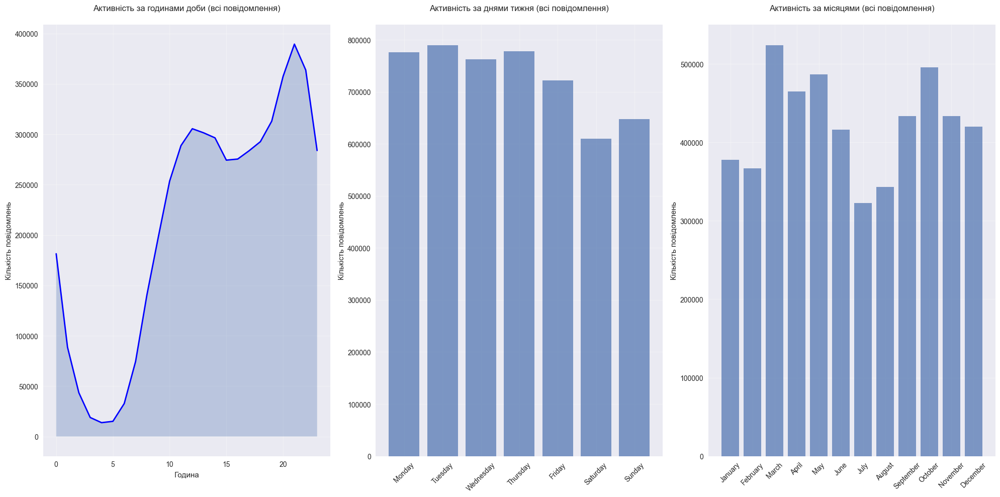

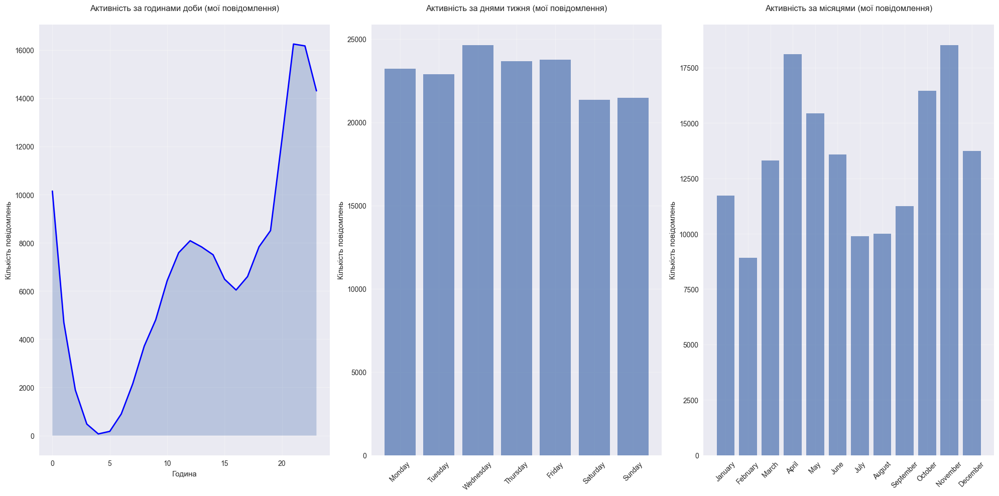

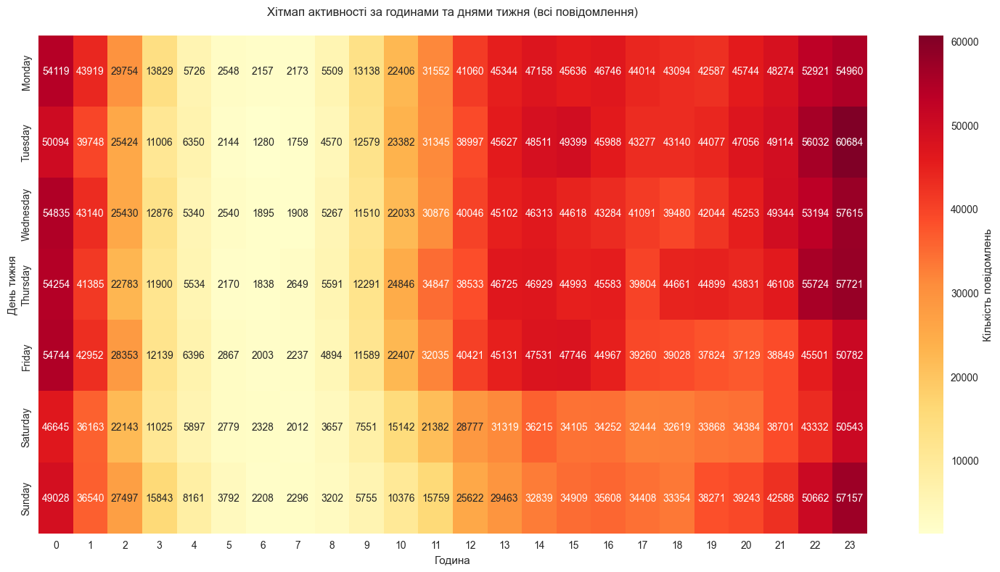

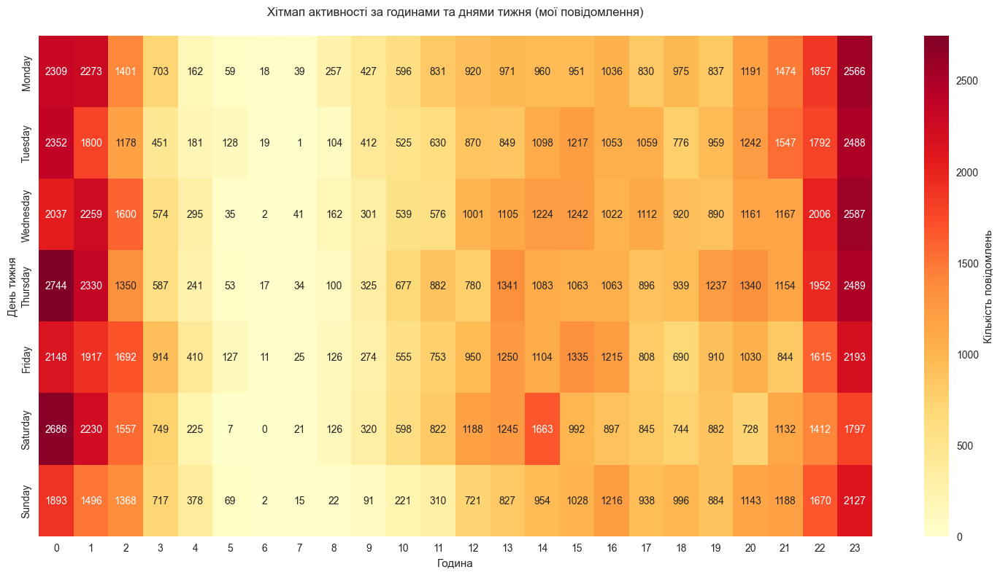

In [37]:
def analyze_temporal_patterns(df, title_suffix=''):
    # Переконуємося, що дата у правильному форматі
    df['date'] = pd.to_datetime(df['date']) + pd.Timedelta(hours=2)

    # Додаємо часові компоненти
    df['hour'] = df['date'].dt.hour
    df['day_of_week'] = df['date'].dt.day_name()
    df['month'] = df['date'].dt.month_name()
    
    # Створюємо фігуру з підграфіками
    fig = plt.figure(figsize=(20, 10))
    
    # 1. Активність за годинами
    plt.subplot(131)
    hourly_activity = df['hour'].value_counts().sort_index()
    plt.plot(hourly_activity.index, hourly_activity.values, 'b-', linewidth=2)
    plt.fill_between(hourly_activity.index, hourly_activity.values, alpha=0.3)
    plt.title(f'Активність за годинами доби {title_suffix}', pad=20)
    plt.xlabel('Година')
    plt.ylabel('Кількість повідомлень')
    plt.grid(True, alpha=0.3)
    
    # 2. Активність за днями тижня
    plt.subplot(132)
    days_order = ['Monday', 'Tuesday', 'Wednesday', 'Thursday', 'Friday', 'Saturday', 'Sunday']
    daily_activity = df['day_of_week'].value_counts()
    daily_activity = daily_activity.reindex(days_order)
    plt.bar(daily_activity.index, daily_activity.values, alpha=0.7)
    plt.title(f'Активність за днями тижня {title_suffix}', pad=20)
    plt.xticks(rotation=45)
    plt.ylabel('Кількість повідомлень')
    plt.grid(True, alpha=0.3)
    
    # 3. Активність за місяцями
    plt.subplot(133)
    months_order = ['January', 'February', 'March', 'April', 'May', 'June', 
                   'July', 'August', 'September', 'October', 'November', 'December']
    monthly_activity = df['month'].value_counts()
    monthly_activity = monthly_activity.reindex(months_order)
    plt.bar(monthly_activity.index, monthly_activity.values, alpha=0.7)
    plt.title(f'Активність за місяцями {title_suffix}', pad=20)
    plt.xticks(rotation=45)
    plt.ylabel('Кількість повідомлень')
    plt.grid(True, alpha=0.3)
    
    plt.tight_layout()
    return fig

# Аналіз хітмапу активності
def create_activity_heatmap(df, title_suffix=''):
    # Додаємо зсув на +2 години
    df['date'] = pd.to_datetime(df['date']) + pd.Timedelta(hours=2)
    
    # Створюємо хітмап активності за годинами та днями тижня
    df['hour'] = df['date'].dt.hour
    df['day_of_week'] = df['date'].dt.day_name()
    
    # Створюємо зведену таблицю
    heatmap_data = pd.crosstab(df['day_of_week'], df['hour'])
    
    # Сортуємо дні тижня
    days_order = ['Monday', 'Tuesday', 'Wednesday', 'Thursday', 'Friday', 'Saturday', 'Sunday']
    heatmap_data = heatmap_data.reindex(days_order)
    
    # Створюємо хітмап
    plt.figure(figsize=(15, 8))
    sns.heatmap(heatmap_data, cmap='YlOrRd', annot=True, fmt='d', cbar_kws={'label': 'Кількість повідомлень'})
    plt.title(f'Хітмап активності за годинами та днями тижня {title_suffix}', pad=20)
    plt.xlabel('Година')
    plt.ylabel('День тижня')
    
    plt.tight_layout()
    return plt.gcf()

# Відокремлюємо всі повідомлення та ваші повідомлення
all_messages_df = df.copy()
my_messages_df = df[df['from_id'] == 'PeerUser(user_id=519270613)'].copy()

# Побудова графіків для всіх повідомлень
fig1_all = analyze_temporal_patterns(all_messages_df, title_suffix='(всі повідомлення)')
fig1_my = analyze_temporal_patterns(my_messages_df, title_suffix='(мої повідомлення)')

fig2_all = create_activity_heatmap(all_messages_df, title_suffix='(всі повідомлення)')
fig2_my = create_activity_heatmap(my_messages_df, title_suffix='(мої повідомлення)')

# Відображення всіх графіків
plt.show()


**Висновок**

З візуалізацій можна помітити, що графік моєї активності не є унікальним та співпадає в тенденції з загальною картиною. 

### 14. Виявлення найбільш активних груп (найбільша кількість повідомлень на 1 учасника)

**Вступ**

Це спроба проаналізувати які групи є найбільш активними, за певним коефіцієнтом.

C:\Users\Dmytro\AppData\Local\Temp\ipykernel_5652\396044193.py:63: MatplotlibDeprecationWarning:

Auto-removal of grids by pcolor() and pcolormesh() is deprecated since 3.5 and will be removed two minor releases later; please call grid(False) first.

C:\Users\Dmytro\AppData\Local\Temp\ipykernel_5652\396044193.py:110: UserWarning:

Glyph 127871 (\N{POPCORN}) missing from current font.

C:\Users\Dmytro\AppData\Local\Temp\ipykernel_5652\396044193.py:110: UserWarning:

Glyph 127963 (\N{CLASSICAL BUILDING}) missing from current font.

C:\Users\Dmytro\AppData\Local\Temp\ipykernel_5652\396044193.py:110: UserWarning:

Glyph 65039 (\N{VARIATION SELECTOR-16}) missing from current font.

D:\Dima\Education\Обсус\Homework4\.venv\lib\site-packages\IPython\core\pylabtools.py:170: UserWarning:

Glyph 127871 (\N{POPCORN}) missing from current font.

D:\Dima\Education\Обсус\Homework4\.venv\lib\site-packages\IPython\core\pylabtools.py:170: UserWarning:

Glyph 127963 (\N{CLASSICAL BUILDING}) missing from 

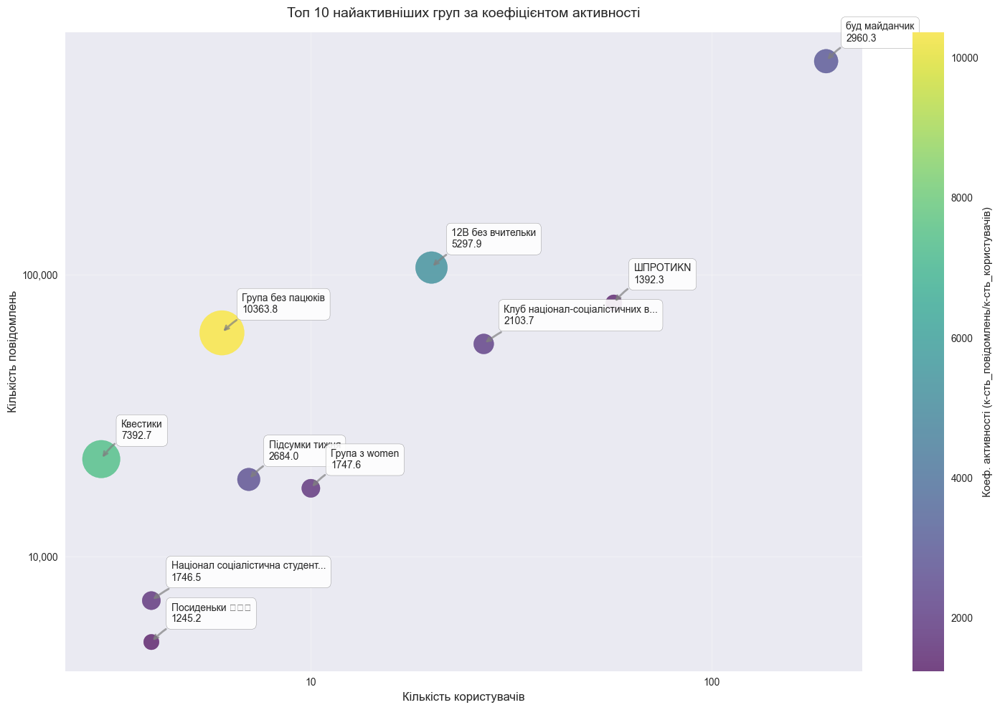

In [38]:
def analyze_group_activity(df, df_meta, top_n=10): 
    # Фільтруємо лише групи, виключаючи небажаний чат
    df_meta = df_meta[
        (df_meta['type'] == 'Group') & 
        (df_meta['name'] != 'popygai4ikkesha(чат)')  # Виключаємо небажаний чат
    ]
    
    def count_unique_users(group_data):
        users_set = set()
        group_data = group_data[group_data['users'].notna()]
        for user_str in group_data['users']:
            try:
                user_dict = ast.literal_eval(user_str)
                users_set.add(user_dict['user_id'])
            except:
                continue
        return len(users_set)
    
    users_per_group = df_meta.groupby('dialog_id').apply(count_unique_users)
    messages_per_group = df.groupby('dialog_id').size()
    
    activity_df = pd.DataFrame({
        'users': users_per_group,
        'messages': messages_per_group
    }).reset_index()
    
    activity_df['activity_ratio'] = activity_df.apply(
        lambda x: x['messages'] / x['users'] if x['users'] > 0 else 0, 
        axis=1
    )
    
    df_meta_unique = df_meta.drop_duplicates(subset=['dialog_id'])[['dialog_id', 'name']]
    activity_df = activity_df.merge(df_meta_unique, on='dialog_id', how='left')
    
    activity_df = activity_df[
        (activity_df['users'] > 0) & 
        (activity_df['messages'] > 0) &
        (activity_df['name'].notna())
    ]
    
    top_groups = activity_df.nlargest(top_n, 'activity_ratio')
    
    if len(top_groups) == 0:
        print("\nПОМИЛКА: Немає даних для візуалізації!")
        return None
    
    plt.style.use('seaborn')
    plt.figure(figsize=(15, 10))
    
    size_scale = 2000 / top_groups['activity_ratio'].max()
    min_size = 200  # Збільшили мінімальний розмір бульбашки
    
    sizes = top_groups['activity_ratio'] * size_scale
    sizes = sizes.clip(lower=min_size)
    
    scatter = plt.scatter(top_groups['users'], 
                         top_groups['messages'],
                         s=sizes,
                         c=top_groups['activity_ratio'],
                         cmap='viridis',
                         alpha=0.7)
    
    plt.colorbar(scatter, label='Коеф. активності (к-сть_повідомлень/к-сть_користувачів)')
    
    plt.title(f'Топ {top_n} найактивніших груп за коефіцієнтом активності', fontsize=14, pad=15)
    plt.xlabel('Кількість користувачів', fontsize=12)
    plt.ylabel('Кількість повідомлень', fontsize=12)
    plt.grid(True, alpha=0.3)
    
    plt.xscale('log')
    plt.yscale('log')
    
    def format_func(x, p):
        if x < 1:
            return "0"
        return format(int(x), ',')
    
    plt.gca().xaxis.set_major_formatter(plt.FuncFormatter(format_func))
    plt.gca().yaxis.set_major_formatter(plt.FuncFormatter(format_func))
    
    # Покращені підписи
    for idx, row in top_groups.iterrows():
        name = row['name'][:30] + '...' if len(row['name']) > 30 else row['name']
        label = f"{name}\n{row['activity_ratio']:.1f}"
        
        # Збільшений розмір текстового блоку та шрифту
        bbox_props = dict(
            boxstyle="round,pad=0.5",
            fc="white",
            ec="gray",
            alpha=0.9,
            mutation_scale=0.5
        )
        
        # Покращене позиціонування підписів з більшими стрілками
        plt.annotate(label,
                    (row['users'], row['messages']),
                    xytext=(20, 20),  # Збільшена відстань від точки
                    textcoords='offset points',
                    fontsize=10,  # Збільшений розмір шрифту
                    bbox=bbox_props,
                    arrowprops=dict(
                        arrowstyle='->',
                        connectionstyle='arc3,rad=0.2',
                        color='gray',
                        alpha=0.7,
                        linewidth=2  # Збільшена товщина стрілки
                    ))
    
    plt.tight_layout()
    return plt.gcf()

# Використання
fig = analyze_group_activity(df, df_meta)
if fig is not None:
    plt.show()


**Зауваження**: виключено чат, для якого через налаштування безпеки не відображаються інші користувачі.

**Висновок**

Видно, що середня кількість повідомлень на учасника переважно більша в локальних групах.

### 15. Виявлення однакових повідомлень

**Вступ**

Спроба виявити потенційні спам повідомлення


Топ повторювані повідомлення:

1. Повідомлення зустрічається 3941 разів
Кількість унікальних чатів: 8
Розподіл за типами чатів: Group: 2125
Довжина повідомлення: 80 символів
Текст повідомлення:
This message couldn't be displayed on your device due to copyright infringement.
----------------------------------------------------------------------------------------------------

2. Повідомлення зустрічається 2454 разів
Кількість унікальних чатів: 8
Розподіл за типами чатів: Group: 1627
Довжина повідомлення: 237 символів
Текст повідомлення:
❕Відбій повітряної тривоги!

Просимо уважно слідкувати за повідомленнями і, у разі оголошення тривоги, повернутися до укриття.

⚡️⚡️⚡️

❕Air siren all clear!

Please keep an eye on reports and return to shelter if the siren sounds again.
----------------------------------------------------------------------------------------------------

3. Повідомлення зустрічається 2346 разів
Кількість унікальних чатів: 12
Розподіл за типами чатів: Group: 1647
Довжина 

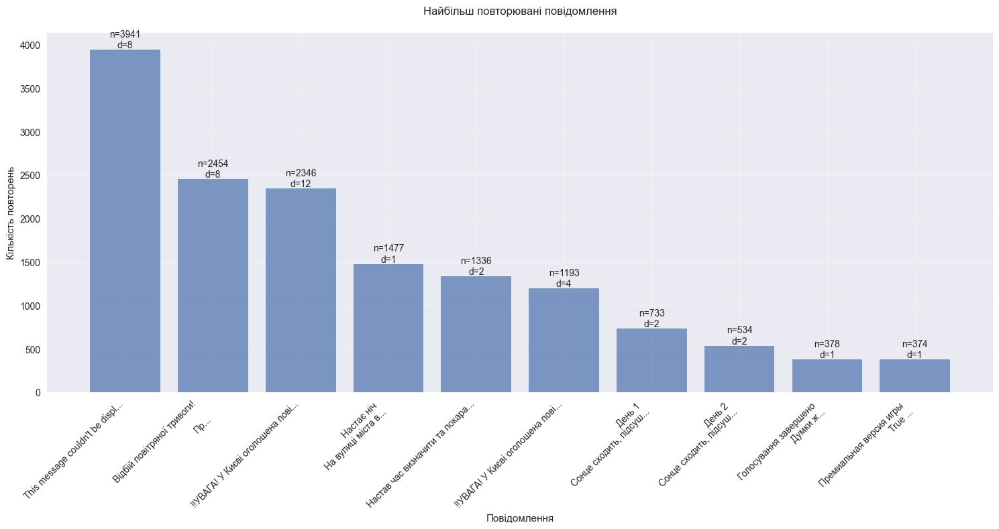

In [39]:
def analyze_most_common_message(df, df_meta, min_length=50, top_n=10):
    """
    Знаходить найбільш повторювані повідомлення серед усіх типів чатів
    """
    # Фільтруємо повідомлення за мінімальною довжиною
    messages_df = df[df['message'].str.len() > min_length].copy()
    
    # Підраховуємо повторення повідомлень
    message_counts = Counter(messages_df['message'].dropna())
    
    # Створюємо датафрейм з результатами
    results = []
    for msg, count in message_counts.most_common(top_n):
        # Знаходимо всі входження цього повідомлення
        occurrences = messages_df[messages_df['message'] == msg]
        
        # Отримуємо унікальні діалоги
        unique_dialogs = occurrences['dialog_id'].unique()
        
        # Отримуємо типи чатів для цього повідомлення
        dialog_types = df_meta[df_meta['dialog_id'].isin(unique_dialogs)]['type'].value_counts()
        chat_types = [f"{type_}: {count}" for type_, count in dialog_types.items()]
        
        results.append({
            'message': msg,
            'count': count,
            'unique_dialogs': len(unique_dialogs),
            'chat_types': ', '.join(chat_types),
            'length': len(msg)
        })
    
    results_df = pd.DataFrame(results)
    
    # Виводимо детальну інформацію
    print("\nТоп повторювані повідомлення:")
    print("=" * 100)
    for idx, row in results_df.iterrows():
        print(f"\n{idx + 1}. Повідомлення зустрічається {row['count']} разів")
        print(f"Кількість унікальних чатів: {row['unique_dialogs']}")
        print(f"Розподіл за типами чатів: {row['chat_types']}")
        print(f"Довжина повідомлення: {row['length']} символів")
        print(f"Текст повідомлення:\n{row['message']}")
        print("-" * 100)
    
    # Створюємо візуалізацію без емодзі
    plt.figure(figsize=(15, 8))
    
    # Створюємо основний графік
    bars = plt.bar(range(len(results_df)), results_df['count'], alpha=0.7)
    
    # Налаштовуємо підписи
    plt.title('Найбільш повторювані повідомлення', pad=20)
    plt.xlabel('Повідомлення')
    plt.ylabel('Кількість повторень')
    
    # Створюємо очищені підписи без емодзі
    def clean_text_for_label(text, max_length=30):
        # Видаляємо емодзі та спеціальні символи
        cleaned = ''.join(c for c in text if ord(c) < 10000)
        # Скорочуємо довгий текст
        if len(cleaned) > max_length:
            cleaned = cleaned[:max_length] + "..."
        return cleaned.strip()
    
    labels = [clean_text_for_label(msg) for msg in results_df['message']]
    
    plt.xticks(range(len(results_df)), labels, rotation=45, ha='right')
    
    # Додаємо значення над стовпчиками
    for idx, bar in enumerate(bars):
        height = bar.get_height()
        dialogs = results_df.iloc[idx]['unique_dialogs']
        plt.text(bar.get_x() + bar.get_width()/2., height,
                f'n={int(height)}\nd={dialogs}',
                ha='center', va='bottom')
    
    plt.grid(True, alpha=0.3)
    plt.tight_layout()
    
    # Виводимо загальну статистику
    total_messages = len(messages_df)
    repeated_messages = len([c for c in message_counts.values() if c > 1])
    
    print("\nЗагальна статистика:")
    print(f"Всього повідомлень: {total_messages:,}")
    print(f"Унікальних повідомлень: {len(message_counts):,}")
    print(f"Повідомлень, що повторюються більше одного разу: {repeated_messages:,}")
    print(f"Максимальна кількість повторень: {max(message_counts.values()):,}")
    
    # Виводимо статистику по типах чатів
    print("\nСтатистика по типах чатів:")
    chat_type_stats = df_meta['type'].value_counts()
    for chat_type, count in chat_type_stats.items():
        print(f"{chat_type}: {count:,}")
    
    return plt.gcf()

# Використання
fig = analyze_most_common_message(df, df_meta)
plt.show()

**Висновок**

Це була спроба виявити спам повідомлення. Проте виявити їх не вдалося, звідки можна зробити висновок, що смак повідомлення якщо і є, то їх не залишають надовго, а видаляють. Однакові повідомлення були або про повітряну тривогу/відбій, або з гри бота мафії 

### 16. Аналіз використання могилянських жаргонізмів у чатах. Спроба знайти їх в напопулярніших повідомленнях за реакціями

**Вступ**

Я вирішив провести аналіз використання могилянських маргонізмів у чатах. Для цього я використав словник створений могилянцями "Спудейський словесник":

https://docs.google.com/document/d/1xzDY1cX7vtole9RAJ4X8dlbacKXXjGwOgfZb1o5Wf-Y/edit?tab=t.0

У словнику зібрані різномінітні терміни, деякі з них є доволі загальними (староста), а деякі є унікальні для могилянської спільноти (бадді, фідо). Частина з них - те як студенти називають викладачів (Глиба, Трон, Захар). Є й зовсім унікальні, що мають інше значення від оригінального (Морг – експрес маршрут із першого плацу на другий, знаходиться через дорогу від прохідної на другий плац). 

Для аналізу необхідно було перетворити текстовий документ у CSV формат. Попередно я розпарсив його використавши LLM, проте потім все одно довелося немало часу витратити на доопрацювання цього файлу, оскільки структура словника значно відрізняється від тої, яку зазвичай використовують в CSV файлах для аналізу даних.

Готовий файл має 386 записів з даними формату (Жаргонізм,Значення,Категорія,Статус).

У даному блоці я переважно зайнявся написанням функцій для обробки та пошуку жаргонізмів у чатах. Складність полягала в тому, що в українській мові одна слово може мати багато різних форм слова (вімінки, множина, рід). В кінці блоку я спробував проаналізувати, чи зустрічаються могилянські жаргонізми в найбільш вподобаних повідомленнях у групах.

In [40]:
def clean_text(text: str) -> str:
    """
    Очищення тексту від розділових знаків та приведення до нижнього регістру
    """
    # Видаляємо розділові знаки, але зберігаємо дефіс для складених слів
    cleaned = re.sub(r'[^\w\s-]', ' ', text)
    # Заміняємо множинні пробіли на один
    cleaned = re.sub(r'\s+', ' ', cleaned)
    # Приводимо до нижнього регістру
    return cleaned.lower().strip()

In [41]:
def generate_word_forms(word: str, debug: bool = False) -> Set[str]:
    """Генерує можливі форми слова"""
    word = clean_text(word)
    
    if ' ' in word or '-' in word:
        return {word}
    
    forms = {word}
    
    # Базові форми для іменників
    base_endings = {
        'ець': ['ець', 'ця', 'цю', 'цем', 'ці', 'це', 'ці', 'ців', 'цям', 'цями', 'цях'],
        'й': ['й', 'я', 'ю', 'єм', 'ї', 'ї', 'ї', 'їв', 'ям', 'ями', 'ях'],
        'ак': ['ак', 'ака', 'аку', 'аком', 'аці', 'аки', 'аків', 'акам', 'аками', 'аках'],
        'ик': ['ик', 'ика', 'ику', 'иком', 'иці', 'ики', 'иків', 'икам', 'иками', 'иках'],
        'ка': ['ка', 'ки', 'ці', 'ку', 'кою', 'ки', 'ок', 'кам', 'ками', 'ках'],
        'а': ['а', 'и', 'і', 'у', 'ою', 'и', 'ам', 'ами', 'ах'],
        'я': ['я', 'і', 'ю', 'єю', 'ї', 'ям', 'ями', 'ях'],
        'ь': ['ь', 'я', 'ю', 'ем', 'і', 'і', 'ів', 'ям', 'ями', 'ях'],
    }
    
    # Додаткові форми для специфічних слів
    special_cases = {
        'плац': ['плац', 'плацу', 'плацом', 'плаці', 'плаців', 'плацам', 'плацами', 'плацах'],
        'спуде': ['спудей', 'спудея', 'спудею', 'спудеєм', 'спудеї', 'спудеї', 'спудеїв', 'спудеям', 'спудеями', 'спудеях'],
        'могилян': ['могилянець', 'могилянця', 'могилянцю', 'могилянцем', 'могилянці', 'могилянці', 'могилянців', 'могилянцям', 'могилянцями', 'могилянцях']
    }
    
    # Перевірка на спеціальні випадки
    for base, special_forms in special_cases.items():
        if word.startswith(base):
            forms.update(special_forms)
            if debug:
                print(f"Special case '{base}': {special_forms}")
    
    # Генерація форм на основі закінчень
    stem = word
    for end, variants in base_endings.items():
        if word.endswith(end):
            stem = word[:-len(end)]
            new_forms = {stem + variant for variant in variants}
            forms.update(new_forms)
            if debug:
                print(f"Base ending '{end}': {new_forms}")
    
    if debug:
        print(f"Generated forms for '{word}': {forms}")
    
    return forms

In [42]:
def prepare_jargon_forms(jargon_df: pd.DataFrame) -> Dict[str, Dict]:
    """Підготовка словника жаргонізмів"""
    jargon_forms = {}
    
    for _, row in tqdm(jargon_df.iterrows(), desc="Підготовка форм жаргонізмів"):
        term = clean_text(row['Жаргонізм'])
        
        # Генеруємо форми для кожного слова в терміні
        if ' ' in term:
            words = term.split()
            word_forms = [generate_word_forms(word) for word in words]
            # Створюємо всі можливі комбінації форм слів
            combined_forms = set()
            for forms in itertools.product(*word_forms):
                combined_forms.add(' '.join(forms))
            forms = combined_forms
        else:
            forms = generate_word_forms(term)
        
        # Додаємо всі форми до словника
        for form in forms:
            if form in jargon_forms:
                if row['Значення'] not in jargon_forms[form]['meanings']:
                    jargon_forms[form]['meanings'].append(row['Значення'])
            else:
                jargon_forms[form] = {
                    'original': term,
                    'meanings': [row['Значення']],
                    'category': row['Категорія'],
                    'status': row['Статус']
                }
    
    return jargon_forms

In [43]:
def parse_reactions(reactions_str: str) -> Tuple[int, Dict]:
    """Парсинг реакцій"""
    if pd.isna(reactions_str) or reactions_str == '{}':
        return 0, {}
    try:
        reactions_dict = ast.literal_eval(reactions_str)
        return len(reactions_dict), reactions_dict
    except:
        return 0, {}

def format_sender(sender: str) -> str:
    """Форматування відправника"""
    if pd.isna(sender):
        return 'Unknown'
    if isinstance(sender, str) and 'PeerUser' in sender:
        return sender.split('=')[1].rstrip(')')
    return str(sender)

In [44]:
def analyze_messages_with_jargon(df: pd.DataFrame, 
                               df_meta: pd.DataFrame, 
                               jargon_forms: Dict,
                               n_messages: int = 10) -> List[Dict]:
    """Аналіз повідомлень"""
    # Фільтруємо групові чати
    group_dialogs = df_meta[
        (df_meta['type'] != 'Private dialog') & 
        (df_meta['name'] != 'popygai4ikkesha(чат)')
    ]['dialog_id'].unique()
    
    group_messages = df[df['dialog_id'].isin(group_dialogs)].copy()
    
    # Аналіз реакцій (без tqdm)
    reaction_data = [parse_reactions(r) for r in group_messages['reactions']]
    group_messages['reaction_count'] = [r[0] for r in reaction_data]
    group_messages['reaction_dict'] = [r[1] for r in reaction_data]
    
    # Пошук жаргону
    print("Аналіз повідомлень...")
    # Використовуємо один tqdm для всього процесу
    with tqdm(total=len(group_messages)) as pbar:
        jargon_data = []
        batch_size = 1000
        
        for i in range(0, len(group_messages), batch_size):
            batch = group_messages['message'].iloc[i:i+batch_size]
            batch_results = []
            
            for message in batch:
                text = str(message) if pd.notna(message) else ""
                batch_results.append(find_jargon_in_text(text, jargon_forms))
            
            jargon_data.extend(batch_results)
            pbar.update(len(batch))
    
    group_messages['jargon_data'] = jargon_data
    group_messages['jargon_count'] = [len(j) for j in jargon_data]
    
    # Отримуємо назви чатів
    chat_names = df_meta.set_index('dialog_id')['name'].to_dict()
    
    # Сортуємо за кількістю реакцій та жаргону
    top_messages = group_messages.nlargest(n_messages, ['reaction_count', 'jargon_count'])
    
    results = []
    for _, msg in top_messages.iterrows():
        message_text = str(msg['message']) if pd.notna(msg['message']) else '<Медіа>'
        if len(message_text) > 100:
            message_text = message_text[:97] + '...'
            
        date_str = pd.to_datetime(msg['date']).strftime('%Y-%m-%d %H:%M')
        
        # Форматуємо реакції
        reaction_counts = defaultdict(int)
        for reaction in msg['reaction_dict'].values():
            reaction_counts[reaction] += 1
        reactions_str = ' '.join([f"{r}({c})" for r, c in 
                               sorted(reaction_counts.items(), key=lambda x: x[1], reverse=True)])
        
        # Форматуємо жаргон
        jargon_info = msg['jargon_data']
        jargon_str = ', '.join([f"{term} ({meaning})" for term, meaning, _ in jargon_info])
        
        results.append({
            'chat_name': chat_names.get(msg['dialog_id'], 'Unknown Chat'),
            'date': date_str,
            'sender': format_sender(msg['from_id']),
            'message': message_text,
            'total_reactions': msg['reaction_count'],
            'reactions_breakdown': reactions_str,
            'jargon_used': jargon_str,
            'jargon_count': len(jargon_info)
        })
    
    return results

In [45]:
def find_jargon_in_text(text: str, jargon_forms: Dict, debug: bool = False) -> List[Tuple[str, str, str]]:
    """Пошук жаргонізмів у тексті"""
    if pd.isna(text):
        return []
    
    found_terms = []
    text = clean_text(text)
    if debug:
        print(f"\nAnalyzing text: '{text}'")
    
    # Спочатку шукаємо складені терміни
    for term, info in jargon_forms.items():
        if ' ' in term and term in text:
            meanings = [str(m) for m in info['meanings']]
            found_terms.append((
                term,
                ' / '.join(meanings),
                info['category']
            ))
            if debug:
                print(f"Found compound term: '{term}'")
    
    # Потім шукаємо окремі слова
    words = text.split()
    for word in words:
        word = clean_text(word)
        if debug:
            print(f"\nChecking word: '{word}'")
        
        # Генеруємо форми для поточного слова
        word_forms = generate_word_forms(word, debug)
        
        # Перевіряємо кожну форму
        for form in word_forms:
            if form in jargon_forms:
                info = jargon_forms[form]
                meanings = [str(m) for m in info['meanings']]
                found_terms.append((
                    word,
                    ' / '.join(meanings),
                    info['category']
                ))
                if debug:
                    print(f"Found match: '{word}' (form: '{form}')")
                break
            elif debug:
                print(f"Form not found in dictionary: '{form}'")
    
    return found_terms

In [46]:
def print_jargon_analysis(results: List[Dict]):
    """Покращений вивід результатів аналізу"""
    print("\n=== Аналіз повідомлень з могилянським жаргоном ===\n")

    
    for i, msg in enumerate(results, 1):
        print(f"{i}. {msg['chat_name']} - {msg['date']}")
        print(f"Повідомлення: {msg['message']}\n")
        
        if msg['jargon_used']:
            print("Знайдені жаргонізми:")
            jargon_terms = msg['jargon_used'].split(', ')
            unique_terms = set()
            
            for term in jargon_terms:
                if ' (' in term:
                    word, meaning = term.split(' (', 1)
                    meaning = meaning.rstrip(')')
                    if word not in unique_terms:
                        unique_terms.add(word)
                        print(f"• {word}")
                        print(f"  Значення: {meaning}")
            
        if msg['reactions_breakdown']:
            print("Реакції:")
            reactions = msg['reactions_breakdown'].split()
            for reaction in reactions:
                emoji, count = reaction.split('(')
                count = count.rstrip(')')
                print(f"• {emoji:<4} - {count}")
            
        print("-" * 80 + "\n")
    
    # Додаємо статистику
    total_jargon = sum(msg['jargon_count'] for msg in results)
    total_reactions = sum(msg['total_reactions'] for msg in results)
    
    print("Статистика:")
    print(f"• Проаналізовано повідомлень: {len(results)}")
    print(f"• Знайдено унікальних жаргонізмів: {total_jargon}")
    if len(results) > 0:
        print(f"• Середня кількість жаргонізмів на повідомлення: {total_jargon/len(results):.2f}")
        print(f"• Середня кількість реакцій на повідомлення: {total_reactions/len(results):.2f}")
    
    print("\nРозподіл за категоріями:")
    categories = defaultdict(int)
    for msg in results:
        if msg['jargon_used']:
            for term, _, category in find_jargon_in_text(msg['message'], jargon_forms):
                categories[category] += 1
    
    for category, count in sorted(categories.items(), key=lambda x: x[1], reverse=True):
        print(f"• {category:<30} - {count:>3} використань")

In [47]:
# Цей код виводить топ 10 по реакціях повідомлень і знайдені жаргонізми в ньому. 
# Проте він не є оптимальним, довго виконуєтться і аналізує всі повідомлення в групах.
# Проте цей код демонструє, що функції робочі та виконують необіхдну роль
# Ці функції будуть використовуватись і надалі
#
# # Використання:
# jargon_df = pd.read_csv('kma_jargon.csv')
# jargon_forms = prepare_jargon_forms(jargon_df)
# 
# results = analyze_messages_with_jargon(df, df_meta, jargon_forms)
# print_jargon_analysis(results)

In [48]:
def analyze_top_messages_with_jargon(df, df_meta, jargon_forms, n_messages=10):
    """Аналіз топових повідомлень на наявність жаргону"""
    # Спочатку знаходимо топові повідомлення
    group_dialogs = df_meta[
        (df_meta['type'] != 'Private dialog') & 
        (df_meta['name'] != 'popygai4ikkesha(чат)')
    ]['dialog_id'].unique()
    
    group_messages = df[df['dialog_id'].isin(group_dialogs)].copy()
    
    # Аналіз реакцій
    reaction_data = [parse_reactions(r) for r in group_messages['reactions']]
    group_messages['reaction_count'] = [r[0] for r in reaction_data]
    group_messages['reaction_dict'] = [r[1] for r in reaction_data]
    
    # Знаходимо топ N повідомлень за кількістю реакцій
    top_messages = group_messages.nlargest(n_messages, 'reaction_count')
    
    # Отримуємо назви чатів
    chat_names = df_meta.set_index('dialog_id')['name'].to_dict()
    
    # Аналізуємо жаргон тільки в топових повідомленнях
    results = []
    for _, msg in top_messages.iterrows():
        message_text = str(msg['message']) if pd.notna(msg['message']) else '<Медіа>'
        if len(message_text) > 100:
            message_text = message_text[:97] + '...'
            
        date_str = pd.to_datetime(msg['date']).strftime('%Y-%m-%d %H:%M')
        
        # Форматуємо реакції
        reaction_counts = defaultdict(int)
        for reaction in msg['reaction_dict'].values():
            reaction_counts[reaction] += 1
        reactions_str = ' '.join([f"{r}({c})" for r, c in 
                               sorted(reaction_counts.items(), key=lambda x: x[1], reverse=True)])
        
        # Аналізуємо жаргон в повідомленні
        jargon_info = find_jargon_in_text(message_text, jargon_forms)
        jargon_str = ', '.join([f"{term} ({meaning})" for term, meaning, _ in jargon_info])
        
        results.append({
            'chat_name': chat_names.get(msg['dialog_id'], 'Unknown Chat'),
            'date': date_str,
            'sender': format_sender(msg['from_id']),
            'message': message_text,
            'total_reactions': msg['reaction_count'],
            'reactions_breakdown': reactions_str,
            'jargon_used': jargon_str,
            'jargon_count': len(jargon_info),
            'jargon_data': jargon_info
        })
    
    return results

def print_combined_analysis(results):
    """Виведення результатів аналізу топових повідомлень з жаргоном"""
    print("\n=== Аналіз топових повідомлень з могилянським жаргоном ===\n")
    
    for i, msg in enumerate(results, 1):
        print(f"{i}. {msg['chat_name']} - {msg['date']}")
        print(f"Повідомлення: {msg['message']}\n")
        
        if msg['jargon_used']:
            print("Знайдені жаргонізми:")
            for term, meaning, category in msg['jargon_data']:
                print(f"• {term}")
                print(f"  Значення: {meaning}")
                print(f"  Категорія: {category}")
        
        print("\nРеакції:")
        reactions = msg['reactions_breakdown'].split()
        for reaction in reactions:
            emoji, count = reaction.split('(')
            count = count.rstrip(')')
            print(f"• {emoji:<4} - {count}")
        
        print("-" * 80 + "\n")
    
    # Статистика
    total_jargon = sum(msg['jargon_count'] for msg in results)
    total_reactions = sum(msg['total_reactions'] for msg in results)
    
    print("Загальна статистика:")
    print(f"• Проаналізовано повідомлень: {len(results)}")
    print(f"• Знайдено жаргонізмів: {total_jargon}")
    if len(results) > 0:
        print(f"• Середня кількість жаргонізмів на повідомлення: {total_jargon/len(results):.2f}")
        print(f"• Середня кількість реакцій на повідомлення: {total_reactions/len(results):.2f}")
    
    print("\nРозподіл за категоріями:")
    categories = defaultdict(int)
    for msg in results:
        for _, _, category in msg['jargon_data']:
            categories[category] += 1
    
    for category, count in sorted(categories.items(), key=lambda x: x[1], reverse=True):
        print(f"• {category:<30} - {count:>3} використань")

In [49]:
# Використання:
jargon_df = pd.read_csv('kma_jargon.csv')
jargon_forms = prepare_jargon_forms(jargon_df)

results = analyze_top_messages_with_jargon(df, df_meta, jargon_forms)
print_combined_analysis(results)

Підготовка форм жаргонізмів: 386it [00:00, 8227.97it/s]



=== Аналіз топових повідомлень з могилянським жаргоном ===

1. Могилянський Кібер-плац - 2023-03-13 19:45
Повідомлення: Всім привіт!

Пишу трохи про поточний стан справ щодо чату "Могилянський Кібер-плац". В цілому сп...

Знайдені жаргонізми:
• могилянський
  Значення: НаУКМА. / людина зі спільноти НаУКМА.
  Категорія: Загальні поняття могилянства

Реакції:
• 👎    - 38
• 👍    - 31
• 🫡    - 6
• 🤡    - 2
• 🤯    - 2
• 💅    - 1
• 🐳    - 1
--------------------------------------------------------------------------------

2. ФІ - 2024-05-23 06:36
Повідомлення: @trosha_b з днем народження 🎉

Усі хто привітають Трохима успішно здадуть сесію 🤓


Реакції:
• 🍾    - 76
• ❤    - 3
--------------------------------------------------------------------------------

3. ФІ - 2023-03-02 11:06
Повідомлення: by Артем Гак


Реакції:
• 👍    - 61
• 😁    - 3
• 💔    - 2
• 🍓    - 2
• 🌚    - 1
• 👀    - 1
• 🍌    - 1
• 🔥    - 1
--------------------------------------------------------------------------------

4. ФІ -

**Висновок**

Написання цих функцій дозволо провести подальний аналіз у наступних блоках. Окрім того, не дивно, що жаргон був виявлений саме в повідомленнях могилянських чатів.

### 17. Пошук використання жаргонізмів у деяких  чатах. Виведення найбільш вживаних

**Вступ**

Цікаво дізнатися які жаргонізми є найбільш популярними в різних чатах. Для порівняння я взяв 5 чатів (чат з однокурсниками, чат факультету, чат могилянської багахолки, загальноуніверситетський чат, та чат шкільної групи що не пов'язаний з могилянкою).

In [50]:
jargon_forms = prepare_jargon_forms(jargon_df)

Підготовка форм жаргонізмів: 386it [00:00, 9522.47it/s]


In [51]:
def prepare_search_dict(jargon_forms: Dict) -> Dict[str, Tuple[str, str, str]]:
    """
    Підготовка оптимізованого словника для пошуку
    Створює словник, де ключі - всі можливі форми слова,
    а значення - кортеж (оригінальна форма, значення, категорія)
    """
    search_dict = {}
    for base_form, info in jargon_forms.items():
        # Для складених термінів
        if ' ' in base_form or '-' in base_form:
            search_dict[base_form.lower()] = (
                info['original'],
                info['meanings'][0],
                info['category']
            )
        else:
            # Для всіх можливих форм слова
            word_forms = generate_word_forms(base_form)
            for form in word_forms:
                search_dict[form.lower()] = (
                    info['original'],
                    info['meanings'][0],
                    info['category']
                )
    return search_dict

def find_jargon_optimized(text: str, search_dict: Dict) -> List[Tuple[str, str, str]]:
    """Оптимізований пошук жаргонізмів"""
    if pd.isna(text):
        return []
    
    found_terms = []
    text = clean_text(text)
    
    # Шукаємо складені терміни
    for term, (original, meaning, category) in search_dict.items():
        if ' ' in term and term in text:
            found_terms.append((original, meaning, category))
    
    # Шукаємо окремі слова
    words = set(text.split())  # використовуємо set для унікальних слів
    for word in words:
        if word in search_dict:
            original, meaning, category = search_dict[word]
            found_terms.append((original, meaning, category))
    
    return found_terms

def analyze_chat_jargon(dialog_id: str, df: pd.DataFrame, df_meta: pd.DataFrame, jargon_forms: Dict, limit: int = -1):
    """
    Аналіз використання жаргону в конкретному чаті
    
    Args:
        dialog_id: ID чату для аналізу
        df: DataFrame з повідомленнями
        df_meta: DataFrame з метаданими чатів
        jargon_forms: словник форм жаргонізмів
        limit: кількість жаргонізмів для виводу (-1 для виводу всіх)
    """
    # Підготовка оптимізованого словника для пошуку
    print("Підготовка словника для пошуку...")
    search_dict = prepare_search_dict(jargon_forms)
    
    # Перевірка наявності чату
    chat_info_df = df_meta[df_meta['dialog_id'].astype(str) == dialog_id]
    if len(chat_info_df) == 0:
        print(f"\nПомилка: Чат з ID {dialog_id} не знайдено.")
        return
    
    chat_info = chat_info_df.iloc[0]
    chat_messages = df[df['dialog_id'].astype(str) == dialog_id]
    
    if len(chat_messages) == 0:
        print(f"\nПомилка: Не знайдено повідомлень для чату {chat_info['name']}")
        return
    
    # Базова інформація про чат
    creation_date = pd.to_datetime(chat_messages['date'].min()).strftime('%Y-%m-%d')
    
    print("\n=== Інформація про чат ===")
    print(f"Назва: {chat_info['name']}")
    print(f"Тип чату: {chat_info['type']}")
    print(f"Кількість повідомлень: {len(chat_messages):,}")
    print(f"Дата створення: {creation_date}")
    
    # Аналіз жаргону
    print("\n=== Аналіз використання жаргону ===")
    
    jargon_usage = defaultdict(int)
    jargon_examples = defaultdict(set)
    
    print("Аналізуємо повідомлення...")
    
    # Обробляємо повідомлення пакетами
    batch_size = 10000
    total_batches = len(chat_messages) // batch_size + 1
    
    for batch_idx in tqdm(range(total_batches)):
        start_idx = batch_idx * batch_size
        end_idx = min((batch_idx + 1) * batch_size, len(chat_messages))
        batch = chat_messages.iloc[start_idx:end_idx]
        
        for _, message in batch.iterrows():
            if pd.isna(message['message']):
                continue
                
            found_terms = find_jargon_optimized(str(message['message']), search_dict)
            
            for original, meaning, _ in found_terms:
                jargon_usage[original] += 1
                if len(jargon_examples[original]) < 3:
                    text = str(message['message'])
                    if len(text) > 100:
                        text = text[:97] + "..."
                    jargon_examples[original].add(text)
    
    # Виводимо результати
    if jargon_usage:
        total_found = len(jargon_usage)
        sorted_terms = sorted(jargon_usage.items(), key=lambda x: x[1], reverse=True)
        
        print("\nЧастота використання жаргонізмів:")
        if limit > 0:
            print(f"(показано топ-{min(limit, total_found)} з {total_found} знайдених)")
        print("-" * 80)
        
        # Обмежуємо вивід якщо встановлено limit
        terms_to_show = sorted_terms[:limit] if limit > 0 else sorted_terms
        
        for term, count in terms_to_show:
            print(f"\n• {term} ({count:,} разів)")
            if jargon_examples[term]:
                print("\n  Приклади використання:")
                for i, example in enumerate(jargon_examples[term], 1):
                    print(f"  {i}. {example}")
            print("-" * 80)
        
        total_usage = sum(jargon_usage.values())
        unique_terms = len(jargon_usage)
        
        print("\nЗагальна статистика:")
        print(f"• Всього використань жаргонізмів: {total_usage:,}")
        print(f"• Унікальних жаргонізмів: {unique_terms:,}")
        print(f"• Середня кількість жаргону на повідомлення: {total_usage/len(chat_messages):.2f}")
        
    else:
        print("\nВ чаті не знайдено використання могилянського жаргону.")

#### 17.1 ШПРОТИKN

**ШПРОТИKN** - чат з бадді та однокурсниками

In [52]:
# ШПРОТИKN
dialog_id = "-1001806752179"
analyze_chat_jargon(dialog_id, df, df_meta, jargon_forms, limit=10)

Підготовка словника для пошуку...

=== Інформація про чат ===
Назва: ШПРОТИKN
Тип чату: Group
Кількість повідомлень: 79,363
Дата створення: 2023-08-23

=== Аналіз використання жаргону ===
Аналізуємо повідомлення...


100%|████████████████████████████████████████████████████████████████████████████████████| 8/8 [00:51<00:00,  6.44s/it]


Частота використання жаргонізмів:
(показано топ-10 з 134 знайдених)
--------------------------------------------------------------------------------

• глиба (304 разів)

  Приклади використання:
  1. Глиба 👀
  2. Він же не Глиба – не душить за відвідуваність)
  3. чи фіт з глибою
--------------------------------------------------------------------------------

• мп (272 разів)

  Приклади використання:
  1. це перша з мп
  2. Добрий день. Прошу поширити опитувальник серед студентів, що до змін до навчальних планів наших о...
  3. хтось ще є у дістеду курсах із мп та аісд? шукаю минулорічні дз
--------------------------------------------------------------------------------

• бадді (223 разів)

  Приклади використання:
  1. ну вона ще й бадді
  2. у когось є знайомі політологи 3 курс або контакти бадді?
  3. можливо, вона тобі контакти бадді дасть
--------------------------------------------------------------------------------

• фі (187 разів)

  Приклади використання:
  1. фі core
 

**Висновок**

Видно, що найпопулярнішим є жаргонізм, що позначає викладача (Глиба - Глибовець М. М.). Наступним жаргонізмом є мп, і технічно цей жаргшонізм є скороченням (МП - предмет Мови Програмування), хоч в словнику жаргонізмів він позначає інше поняття (Магістерська програма).

Популярними є й звичні для могилянців слова такі як: бадді, кмц, могилянка, наукма.

зустрічаються і загальноуніверситетські жаргони: автомат, дедлайн, староста.

#### 17.2 Чат Факультету Інформатики 

**Чат ФІ** - чат факультету інформатики

In [53]:
# Чат ФІ
dialog_id = "-1001142723513"
analyze_chat_jargon(dialog_id, df, df_meta, jargon_forms, limit=10)

Підготовка словника для пошуку...

=== Інформація про чат ===
Назва: ФІ
Тип чату: Group
Кількість повідомлень: 380,736
Дата створення: 2017-10-02

=== Аналіз використання жаргону ===
Аналізуємо повідомлення...


100%|██████████████████████████████████████████████████████████████████████████████████| 39/39 [04:04<00:00,  6.28s/it]


Частота використання жаргонізмів:
(показано топ-10 з 200 знайдених)
--------------------------------------------------------------------------------

• фі (1,847 разів)

  Приклади використання:
  1. нагадало мої повідомлення в чаті фі просто
  2. Частина чату фі грала в гру і оцінюють її не "з дивану"
  3. фі
--------------------------------------------------------------------------------

• кмц (775 разів)

  Приклади використання:
  1. Тренінг з такмеду від MILIT15!

Сьогодні кожен українець може опинитися в умовах критичної ситуац...
  2. з близькими друзями на кмц
  3. на кмц стрижу
--------------------------------------------------------------------------------

• наукма (594 разів)

  Приклади використання:
  1. напиши пост-анонс лекції… ой, gpt це не той чат. 🫣

то що? майбутнє штучного інтелекту: ми чи нас...
  2. Навіть в навчальних корпусах та гуртожитках заблокують Telegram студентам та іншим освітянам Моги...
  3. хахах
є така думка одна цікава
але все ж є барахолка наукм

**Висновок**

Видно, що найпопулярнішим жаргоном є ФІ - назва самого факультету. Серед них також багато загальномогилянського жаргону.

Окремим чином варто звернути увагу на ММ - з прикладів видно, що частина цього слова використовується як жаргон (ММ - Глибовець Микола миколайович), а частина як звичайне службове слово. Тому аналіз не можна вважати абсолютно точним і часом він потребує окремого семантичного аналізу.

#### 17.3 Baraholka NaUKMA Chat

**Baraholka NaUKMA Chat** - чат могилянської барахолки

In [54]:
# Baraholka NaUKMA Chat
dialog_id = "-1001218251741"
analyze_chat_jargon(dialog_id, df, df_meta, jargon_forms, limit=10)

Підготовка словника для пошуку...

=== Інформація про чат ===
Назва: Baraholka NaUKMA Chat
Тип чату: Group
Кількість повідомлень: 71,918
Дата створення: 2018-10-02

=== Аналіз використання жаргону ===
Аналізуємо повідомлення...


100%|████████████████████████████████████████████████████████████████████████████████████| 8/8 [00:39<00:00,  5.00s/it]


Частота використання жаргонізмів:
(показано топ-10 з 148 знайдених)
--------------------------------------------------------------------------------

• могилянець (235 разів)

  Приклади використання:
  1. От так в могилянці стали легально вирощувати травку. От нєт щоб жити зі мною, вона живе десь там
  2. Стартерпак крінж могилянця
Кава на безлактозному
Любов до кма 
Веган боул
Незвичний муз.смак
Вмін...
  3. в могилянці навпаки навчаються хорнічності
--------------------------------------------------------------------------------

• троя (181 разів)

  Приклади використання:
  1. Хтось випадково не продає 
- сушарку для одягу 
- заварник для чаю 
- холодильник(бажано троя)
??
  2. @MrL1s або можу просто зерна віддати цього люпину, розсадите по трої)
  3. Хтось знає якийсь хороший недорогий центр ремонту техніки неподалік трої?
--------------------------------------------------------------------------------

• могилянка (163 разів)

  Приклади використання:
  1. людина не з могилянки

**Висновок**

Загалом в цьому чаті теж поширений "стандартний" могилянський жаргон. Проте є й цікаві випадки.

Кораблик - назва тусовки, яку організовували на кораблі до повномасштабного вторгнення.

ММ - у цьому чаті воно точно використовується в іншому значенні, не як жаргон. 

#### 17.4 Могилянський Кібер-плац

**Могилянський Кібер-плац** - загальноуніверситетський чат для студентів з верифікацією через корпоративну пошту

In [55]:
# Могилянський Кібер-плац
dialog_id = "-1001695031361"
analyze_chat_jargon(dialog_id, df, df_meta, jargon_forms, limit=10)

Підготовка словника для пошуку...

=== Інформація про чат ===
Назва: Могилянський Кібер-плац
Тип чату: Group
Кількість повідомлень: 839,512
Дата створення: 2022-02-13

=== Аналіз використання жаргону ===
Аналізуємо повідомлення...


100%|██████████████████████████████████████████████████████████████████████████████████| 84/84 [10:42<00:00,  7.65s/it]


Частота використання жаргонізмів:
(показано топ-10 з 227 знайдених)
--------------------------------------------------------------------------------

• могилянка (1,999 разів)

  Приклади використання:
  1. Алооо
Це є сенс 
Могилянка економить на отопленні, тому і посольства теж 😂
  2. викладачі з англу якісь завжди унікальні чи це могилянка просто
  3. таймкодів нема, але Могилянка наприкінці (як завжди)
--------------------------------------------------------------------------------

• наукма (1,725 разів)

  Приклади використання:
  1. Є доречі паблік НаУКМА в вк
  2. Гайс, а коли нам остаточно рубануть ТГ в НаУКМА, хтось вкурсі?
  3. Чергове істеричне й ірраціональне рішення було прийнято рудиментарними органами НаУКМА. Монстр на...
--------------------------------------------------------------------------------

• могилянець (1,612 разів)

  Приклади використання:
  1. Мелеш за шось там з ними трьот, вони йдуть а він з трібуни каже про провокацію, і мимоволі згадує...
  2. В моги

**Висновок**

В цьому чаті теж багато загальних жаргонів.

У чаті часто обговорюють новини та політику, тому деякі жаргони насправді помилково класифіковані. Міст - якщо жаргон, то це було видання таке. Одеса - місце куди зазвичай їздили під час весняного тижня самостійної роботи (скасований після повномасштабки). Проте в чаті скоріш за все слова використовуються в класичному значенні

#### 17.5 12В без вчительки

**12В без вчительки** - шкільний чат.

Цікаво дізнатися, що буде якщо спробувати знайти могилянський жаргон поза межами могилянських чатів. 

In [56]:
# 12В без вчительки
dialog_id = "-1001441711556"
analyze_chat_jargon(dialog_id, df, df_meta, jargon_forms, limit=10)

Підготовка словника для пошуку...

=== Інформація про чат ===
Назва: 12В без вчительки
Тип чату: Group
Кількість повідомлень: 105,957
Дата створення: 2020-03-12

=== Аналіз використання жаргону ===
Аналізуємо повідомлення...


100%|██████████████████████████████████████████████████████████████████████████████████| 11/11 [01:03<00:00,  5.74s/it]


Частота використання жаргонізмів:
(показано топ-10 з 62 знайдених)
--------------------------------------------------------------------------------

• проц (45 разів)

  Приклади використання:
  1. 10000 проц
  2. Сто проц
  3. Ахахах сто проц
--------------------------------------------------------------------------------

• мороз (33 разів)

  Приклади використання:
  1. Как мороз поживает?
  2. Хахахахах, мороз был бы рад
  3. Вот мороз в свои за сто свеж как кукумбер
--------------------------------------------------------------------------------

• мм (28 разів)

  Приклади використання:
  1. Мм
  2. мм
  3. мм, я за
--------------------------------------------------------------------------------

• тихо (25 разів)

  Приклади використання:
  1. В єбенях все тихо
  2. У нас в гуртожитку були не такі модняві туалети, але в них була функція заглушки зайвих звуків, я...
  3. тихо
--------------------------------------------------------------------------------

• доля (22 разів)

  П

**Висновок**

Видно, що лише 3 жаргонізми визначені правильно (могилянка, могила, общага).

Всі інші мають інше значення і можуть бути жаргонізмом іншої спільноти. Проте це ще раз підтверджує, що результати не завжди є точними і потребують додаткового аналізу

**Загальний висновок**

Помітно, що в різних могилянських чатах використовують різний набір жаргонізмів, при чому не завжди він є жаргоном, на що варто додатково звертати увагую

### 18. Візуалізації використання жаргонізмів у могилянських чатах. Динаміка за місяцями.

**Вступ**

У попередньому блоці виявлено набільш вживані жаргонізми, а в цьому зроблена візуалізація та показана їх динаміка з часом в конкретних чатах

In [57]:
def prepare_search_dict(jargon_forms: Dict) -> Dict[str, Tuple[str, str, str]]:
    """Підготовка оптимізованого словника для пошуку"""
    search_dict = {}
    for form, info in jargon_forms.items():
        search_dict[form.lower()] = (
            info['original'],
            info['meanings'][0],
            info['category']
        )
    return search_dict

def find_jargon_optimized(text: str, search_dict: Dict) -> List[Tuple[str, str, str]]:
    """Оптимізований пошук жаргонізмів"""
    if pd.isna(text):
        return []
    
    found_terms = []
    text = clean_text(text)
    
    # Шукаємо складені терміни
    for term, (original, meaning, category) in search_dict.items():
        if ' ' in term and term in text:
            found_terms.append((original, meaning, category))
    
    # Шукаємо окремі слова
    words = set(text.split())  # використовуємо set для унікальних слів
    for word in words:
        if word in search_dict:
            original, meaning, category = search_dict[word]
            found_terms.append((original, meaning, category))
    
    return found_terms

In [58]:
def analyze_monthly_jargon_usage(chat_messages: pd.DataFrame, search_dict: Dict) -> pd.DataFrame:
    """Аналізує використання жаргонізмів по місяцях"""
    # Створюємо явну копію DataFrame
    chat_messages = chat_messages.copy()
    
    monthly_usage = defaultdict(lambda: {
        'total_usage': 0,
        'unique_terms': set(),
        'message_count': 0,
        'terms_frequency': defaultdict(int)
    })
    
    # Конвертуємо дати в datetime використовуючи .loc
    chat_messages.loc[:, 'date'] = pd.to_datetime(chat_messages['date'])
    chat_messages.loc[:, 'month'] = chat_messages['date'].dt.strftime('%Y-%m')
    
    print("Аналізуємо повідомлення по місяцях...")
    for _, message in tqdm(chat_messages.iterrows(), total=len(chat_messages)):
        if pd.isna(message['message']):
            continue
            
        month = message['month']
        monthly_usage[month]['message_count'] += 1
        
        # Знаходимо жаргонізми в повідомленні
        found_terms = find_jargon_optimized(str(message['message']), search_dict)
        monthly_usage[month]['total_usage'] += len(found_terms)
        
        # Зберігаємо унікальні терміни та їх частоту
        for term, _, _ in found_terms:
            monthly_usage[month]['unique_terms'].add(term)
            monthly_usage[month]['terms_frequency'][term] += 1
    
    # Конвертуємо в DataFrame
    results = []
    for month, data in monthly_usage.items():
        results.append({
            'month': pd.to_datetime(month),
            'total_usage': data['total_usage'],
            'unique_terms': len(data['unique_terms']),
            'message_count': data['message_count'],
            'avg_per_message': round(data['total_usage'] / data['message_count'], 2) if data['message_count'] > 0 else 0,
            'top_terms': ', '.join([f"{term}({count})" for term, count in 
                                  sorted(data['terms_frequency'].items(), 
                                        key=lambda x: x[1], 
                                        reverse=True)[:3]])
        })
    
    return pd.DataFrame(results).sort_values('month')

In [59]:
def get_chat_name(dialog_id: str, df_meta: pd.DataFrame) -> str:
    """Отримує назву чату за його ID"""
    chat_info = df_meta[df_meta['dialog_id'].astype(str) == dialog_id]
    if len(chat_info) == 0:
        return dialog_id  # повертаємо ID якщо чат не знайдено
    return chat_info.iloc[0]['name']

In [60]:
def create_usage_plot(df: pd.DataFrame, dialog_id: str, df_meta: pd.DataFrame, save_path: str = None):
    """Створює графік загального використання жаргонізмів"""
    plt.style.use('seaborn')
    
    # Отримуємо назву чату
    chat_name = get_chat_name(dialog_id, df_meta)
    
    fig, ax = plt.subplots(figsize=(15, 6))
    
    # Основна крива
    ax.plot(df['month'], df['total_usage'], 
            marker='o', linewidth=2, color='#FF6B6B',
            label='Кількість використань')
    
    # Додаємо область під кривою
    ax.fill_between(df['month'], df['total_usage'], 
                   alpha=0.2, color='#FF6B6B')
    
    # Оптимізуємо мітки часу
    n_points = len(df)
    step = max(n_points // 8, 1)
    
    ax.xaxis.set_major_locator(MonthLocator())
    ax.xaxis.set_major_formatter(DateFormatter('%b\n%Y'))
    
    for idx, label in enumerate(ax.get_xticklabels()):
        label.set_visible(idx % step == 0)
    
    plt.setp(ax.get_xticklabels(), rotation=45, ha='right')
    
    ax.set_xlabel('Місяць', fontsize=12)
    ax.set_ylabel('Кількість використань', fontsize=12)
    ax.grid(True, alpha=0.3)
    
    plt.title(f'Динаміка використання жаргонізмів\nу чаті "{chat_name}"', 
              pad=20, fontsize=14)
    
    plt.tight_layout()
    
    if save_path:
        plt.savefig(save_path, dpi=300, bbox_inches='tight')
        print(f"Графік збережено: {save_path}")
    else:
        plt.show()
    
    plt.close()

In [61]:
def create_unique_terms_plot(df: pd.DataFrame, dialog_id: str, df_meta: pd.DataFrame, save_path: str = None):
    """Створює графік кількості унікальних термінів"""
    plt.style.use('seaborn')
    
    # Отримуємо назву чату
    chat_name = get_chat_name(dialog_id, df_meta)
    
    fig, ax = plt.subplots(figsize=(15, 6))
    
    # Стовпчикова діаграма
    bars = ax.bar(df['month'], df['unique_terms'],
                 width=20,
                 color='#4ECDC4',
                 alpha=0.7,
                 label='Унікальні терміни')
    
    # Лінія тренду
    ax.plot(df['month'], df['unique_terms'],
            color='#45B7AF',
            alpha=0.8,
            linewidth=1.5)
    
    # Оптимізуємо мітки часу
    n_points = len(df)
    step = max(n_points // 8, 1)
    
    ax.xaxis.set_major_locator(MonthLocator())
    ax.xaxis.set_major_formatter(DateFormatter('%b\n%Y'))
    
    for idx, label in enumerate(ax.get_xticklabels()):
        label.set_visible(idx % step == 0)
    
    plt.setp(ax.get_xticklabels(), rotation=45, ha='right')
    
    ax.set_xlabel('Місяць', fontsize=12)
    ax.set_ylabel('Кількість унікальних термінів', fontsize=12)
    ax.grid(True, alpha=0.3)
    
    plt.title(f'Різноманітність жаргонізмів\nу чаті "{chat_name}"', 
              pad=20, fontsize=14)
    
    plt.tight_layout()
    
    if save_path:
        plt.savefig(save_path, dpi=300, bbox_inches='tight')
        print(f"Графік збережено: {save_path}")
    else:
        plt.show()
    
    plt.close()

In [62]:
# Отримання даних чату
def get_chat_messages(dialog_id: str, df: pd.DataFrame, df_meta: pd.DataFrame):
    """Отримує повідомлення конкретного чату"""
    if dialog_id not in df_meta['dialog_id'].astype(str).values:
        raise ValueError(f"Чат з ID {dialog_id} не знайдено")
    
    chat_messages = df[df['dialog_id'].astype(str) == dialog_id].copy()
    
    if len(chat_messages) == 0:
        raise ValueError(f"Не знайдено повідомлень для чату {dialog_id}")
    
    return chat_messages

# Повний процес аналізу
def analyze_chat_jargon_monthly(dialog_id: str, df: pd.DataFrame, df_meta: pd.DataFrame, 
                              jargon_forms: Dict, save_plots: bool = False):
    """
    Повний процес аналізу жаргону в чаті
    
    Args:
        dialog_id: ID чату для аналізу
        df: DataFrame з усіма повідомленнями
        df_meta: DataFrame з метаданими чатів
        jargon_forms: словник форм жаргонізмів
        save_plots: чи зберігати графіки у файли
    """
    # Отримуємо повідомлення чату
    chat_messages = get_chat_messages(dialog_id, df, df_meta)
    
    # Створюємо пошуковий словник
    search_dict = prepare_search_dict(jargon_forms)
    
    # Отримуємо помісячні дані
    monthly_data = analyze_monthly_jargon_usage(chat_messages, search_dict)
    
    # Створюємо графіки
    if save_plots:
        create_usage_plot(monthly_data, dialog_id, df_meta, f"usage_analysis_{dialog_id}.png")
        create_unique_terms_plot(monthly_data, dialog_id, df_meta, f"unique_terms_analysis_{dialog_id}.png")
    else:
        create_usage_plot(monthly_data, dialog_id, df_meta)
        create_unique_terms_plot(monthly_data, dialog_id, df_meta)
    
    return monthly_data

In [63]:
def prepare_top_terms_data(df: pd.DataFrame, n_terms: int = 10) -> pd.DataFrame:
    """
    Підготовка даних для аналізу топових жаргонізмів
    
    Args:
        df: DataFrame з помісячними даними
        n_terms: кількість топових термінів для аналізу
    
    Returns:
        DataFrame з частотою використання термінів по місяцях
    """
    # Створюємо словник для підрахунку загальної частоти
    total_freq = defaultdict(int)
    monthly_freq = defaultdict(lambda: defaultdict(int))
    
    # Збираємо дані по кожному місяцю
    for _, row in df.iterrows():
        month = row['month']
        terms_data = row['top_terms'].split(', ')
        
        for term_data in terms_data:
            if not term_data:
                continue
            # Розбираємо строку виду "термін(кількість)"
            term, count = term_data.rsplit('(', 1)
            count = int(count.rstrip(')'))
            
            total_freq[term] += count
            monthly_freq[term][month] = count
    
    # Вибираємо топ N термінів
    top_terms = sorted(total_freq.items(), key=lambda x: x[1], reverse=True)[:n_terms]
    top_terms = [term for term, _ in top_terms]
    
    # Створюємо DataFrame для теплової карти
    heatmap_data = []
    for term in top_terms:
        for month in df['month']:
            heatmap_data.append({
                'term': term,
                'month': month,
                'frequency': monthly_freq[term][month]
            })
    
    return pd.DataFrame(heatmap_data), top_terms

In [64]:
def create_top_terms_bar(df: pd.DataFrame, dialog_id: str, df_meta: pd.DataFrame, save_path: str = None):
    """Створює стовпчикову діаграму топових жаргонізмів"""
    plt.style.use('seaborn')
    
    # Отримуємо назву чату
    chat_name = get_chat_name(dialog_id, df_meta)
    
    # Підготовка даних
    heatmap_data, top_terms = prepare_top_terms_data(df)
    
    # Рахуємо загальну кількість використань для кожного терміну
    term_totals = heatmap_data.groupby('term')['frequency'].sum().sort_values(ascending=True)
    
    # Створюємо графік
    fig, ax = plt.subplots(figsize=(12, 8))
    
    # Створюємо горизонтальну стовпчикову діаграму з одним кольором
    # Використовуємо холодний синій колір (#4ECDC4) як в попередніх графіках
    bars = ax.barh(range(len(term_totals)), term_totals.values, 
                  color='#4ECDC4', alpha=0.7)
    
    # Налаштовуємо осі
    ax.set_yticks(range(len(term_totals)))
    ax.set_yticklabels(term_totals.index)
    
    # Додаємо значення на стовпчики
    for i, v in enumerate(term_totals.values):
        ax.text(v, i, f' {int(v)}', va='center')
    
    # Налаштування графіка
    plt.title(f'Топ жаргонізмів у чаті "{chat_name}"\nза весь період', 
              pad=20, fontsize=14)
    plt.xlabel('Кількість використань')
    
    # Додаємо сітку тільки по горизонталі для кращої читабельності
    ax.grid(True, axis='x', alpha=0.3)
    ax.grid(False, axis='y')
    
    plt.tight_layout()
    
    if save_path:
        plt.savefig(save_path, dpi=300, bbox_inches='tight')
        print(f"Графік збережено: {save_path}")
    else:
        plt.show()
        
    plt.close()

In [65]:
def create_terms_stream(df: pd.DataFrame, dialog_id: str, df_meta: pd.DataFrame, save_path: str = None):
    """
    Створює stream graph для візуалізації зміни популярності термінів
    """
    plt.style.use('seaborn')
    
    # Отримуємо назву чату
    chat_name = get_chat_name(dialog_id, df_meta)
    
    # Підготовка даних
    heatmap_data, top_terms = prepare_top_terms_data(df, n_terms=8)  # Зменшуємо до 8 термінів для кращої читабельності
    
    # Перетворюємо дані у матричний формат
    pivot_data = pd.pivot_table(
        heatmap_data, 
        values='frequency',
        index='month',
        columns='term',
        fill_value=0
    )
    
    # Створюємо графік
    fig, ax = plt.subplots(figsize=(15, 8))
    
    # Використовуємо приємну кольорову палітру
    colors = plt.cm.RdYlBu(np.linspace(0, 1, len(pivot_data.columns)))
    
    # Створюємо stream graph
    ax.stackplot(pivot_data.index, pivot_data.T,
                labels=pivot_data.columns,
                colors=colors,
                alpha=0.8,
                baseline='sym')  # 'sym' для симетричного відображення
    
    # Налаштування осей
    ax.xaxis.set_major_locator(MonthLocator())
    ax.xaxis.set_major_formatter(DateFormatter('%b\n%Y'))
    
    # Оптимізуємо мітки часу
    n_points = len(pivot_data.index)
    step = max(n_points // 8, 1)
    
    for idx, label in enumerate(ax.get_xticklabels()):
        label.set_visible(idx % step == 0)
    
    plt.setp(ax.get_xticklabels(), rotation=45, ha='right')
    
    # Налаштування графіка
    plt.title(f'Динаміка популярності жаргонізмів\nу чаті "{chat_name}"', 
              pad=20, fontsize=14)
    plt.xlabel('Місяць', fontsize=12)
    plt.ylabel('Кількість використань', fontsize=12)
    
    # Розміщуємо легенду справа від графіка
    plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left', 
              borderaxespad=0., frameon=True)
    
    # Налаштовуємо відступи
    plt.tight_layout()
    
    if save_path:
        plt.savefig(save_path, dpi=300, bbox_inches='tight')
        print(f"Графік збережено: {save_path}")
    else:
        plt.show()
        
    plt.close()

C:\Users\Dmytro\AppData\Local\Temp\ipykernel_5652\1302114064.py:14: FutureWarning:

In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`



Аналізуємо повідомлення по місяцях...


100%|██████████████████████████████████████████████████████████████████████████| 79363/79363 [00:55<00:00, 1424.83it/s]


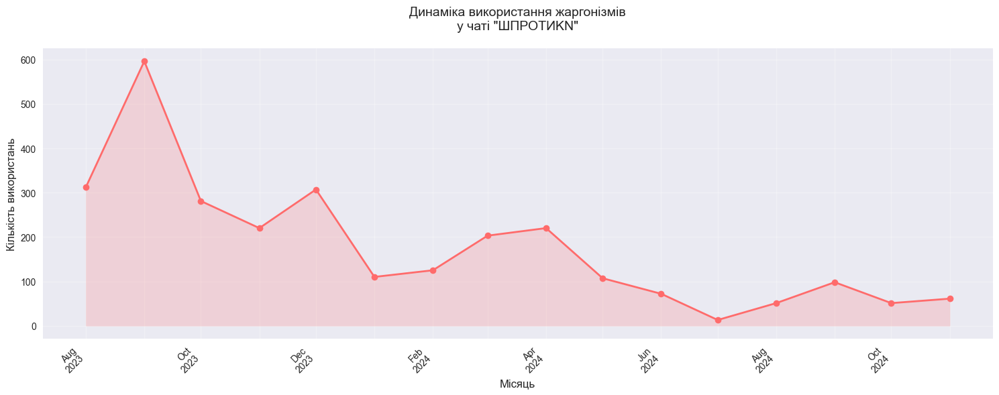

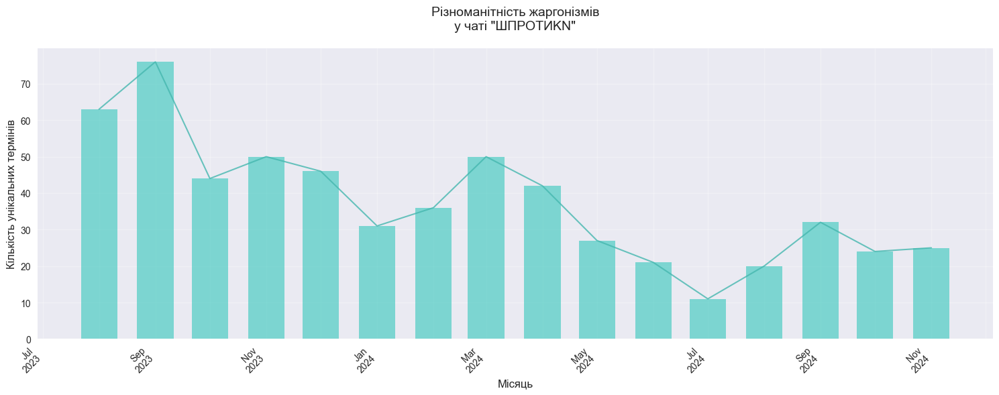

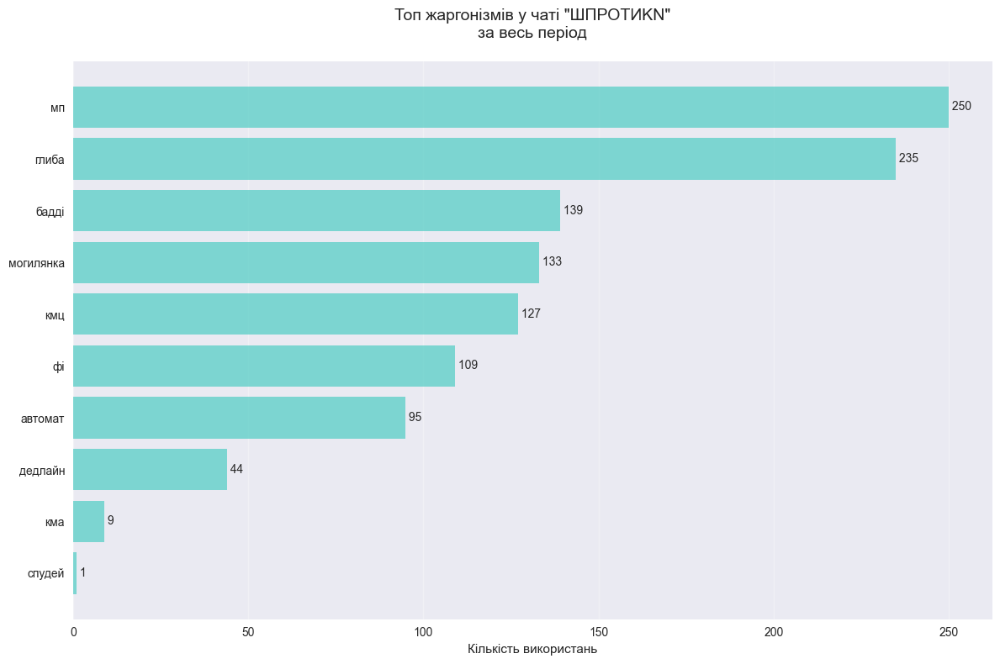

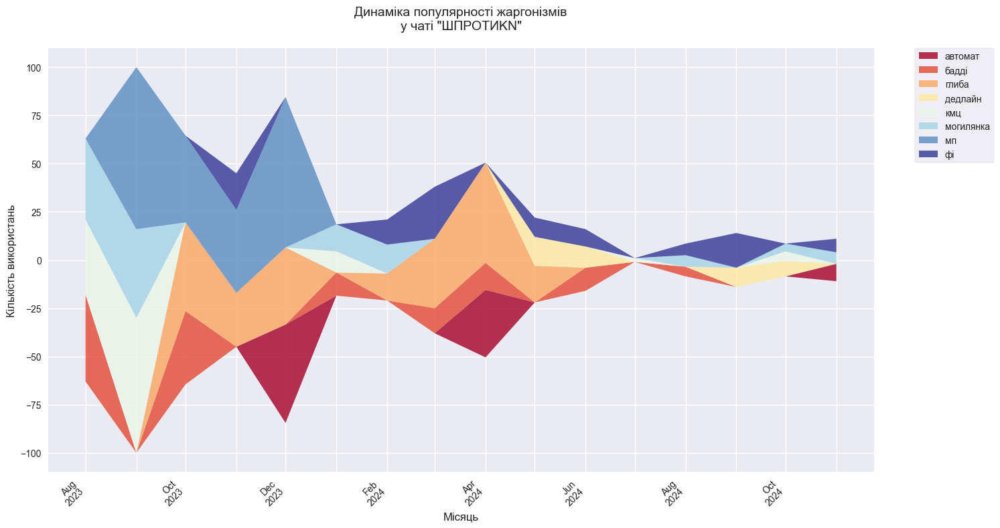

In [66]:
# Використання:
# ШПРОТИKN
dialog_id = "-1001806752179"
monthly_data = analyze_chat_jargon_monthly(dialog_id, df, df_meta, jargon_forms)

# Створення візуалізацій топових жаргонізмів
create_top_terms_bar(monthly_data, dialog_id, df_meta)
create_terms_stream(monthly_data, dialog_id, df_meta)

C:\Users\Dmytro\AppData\Local\Temp\ipykernel_5652\1302114064.py:14: FutureWarning:

In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`



Аналізуємо повідомлення по місяцях...


100%|████████████████████████████████████████████████████████████████████████| 380736/380736 [04:17<00:00, 1479.83it/s]


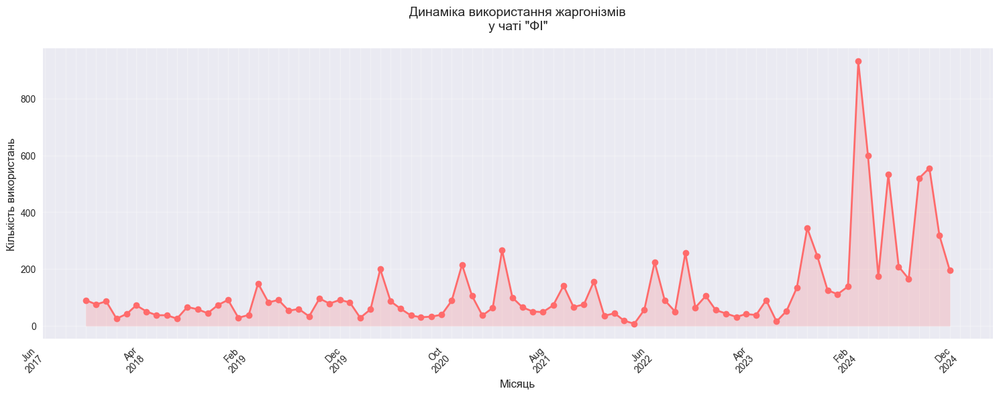

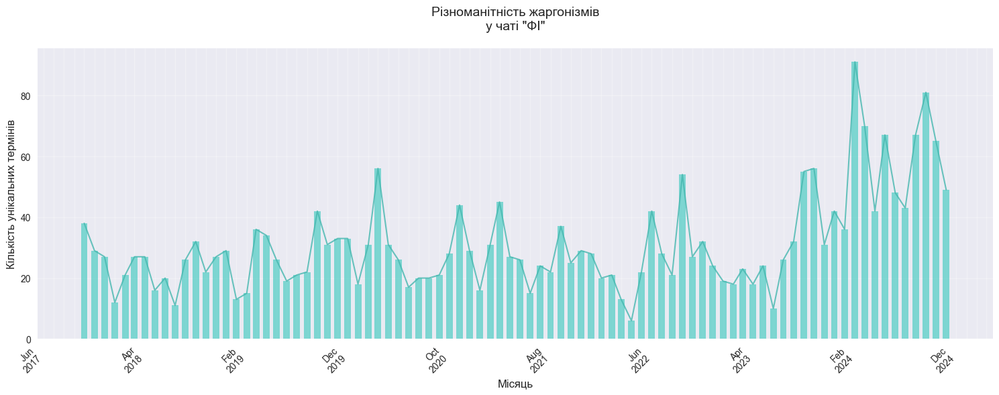

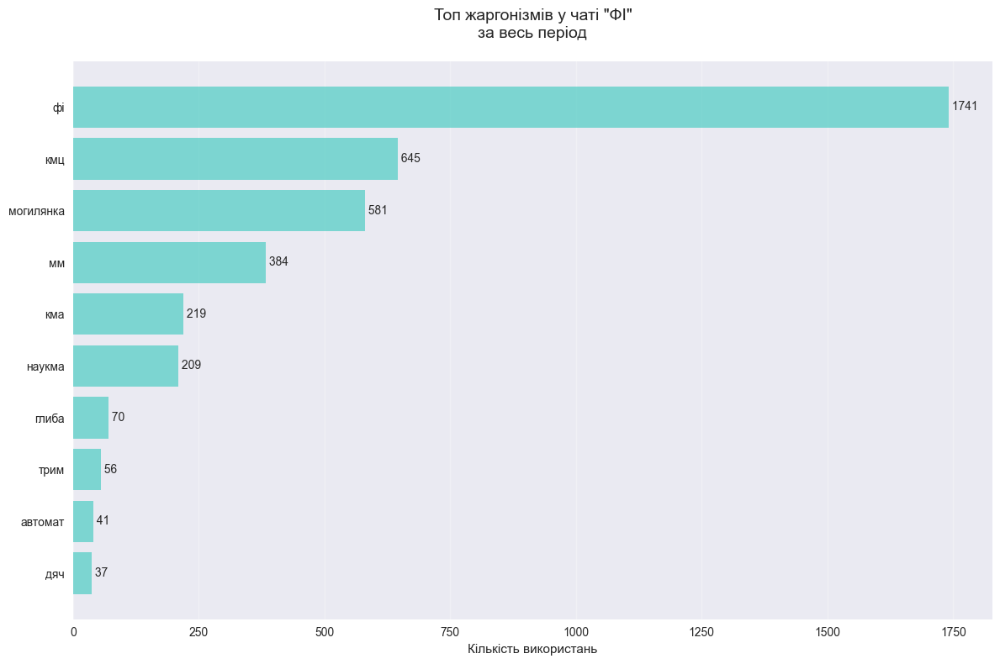

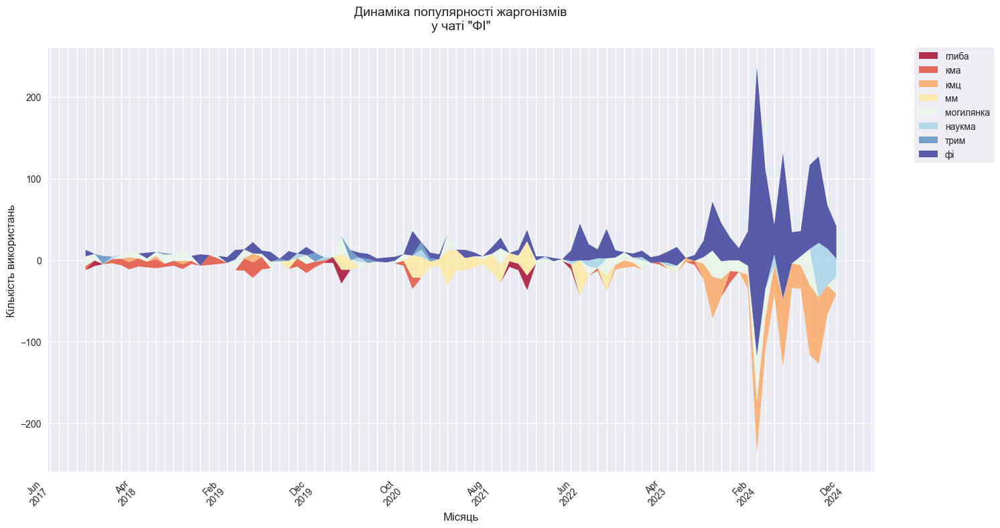

In [67]:
# Використання:
# Чат ФІ
dialog_id = "-1001142723513"
monthly_data = analyze_chat_jargon_monthly(dialog_id, df, df_meta, jargon_forms)

# Створення візуалізацій топових жаргонізмів
create_top_terms_bar(monthly_data, dialog_id, df_meta)
create_terms_stream(monthly_data, dialog_id, df_meta)

C:\Users\Dmytro\AppData\Local\Temp\ipykernel_5652\1302114064.py:14: FutureWarning:

In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`



Аналізуємо повідомлення по місяцях...


100%|██████████████████████████████████████████████████████████████████████████| 71918/71918 [00:42<00:00, 1674.32it/s]


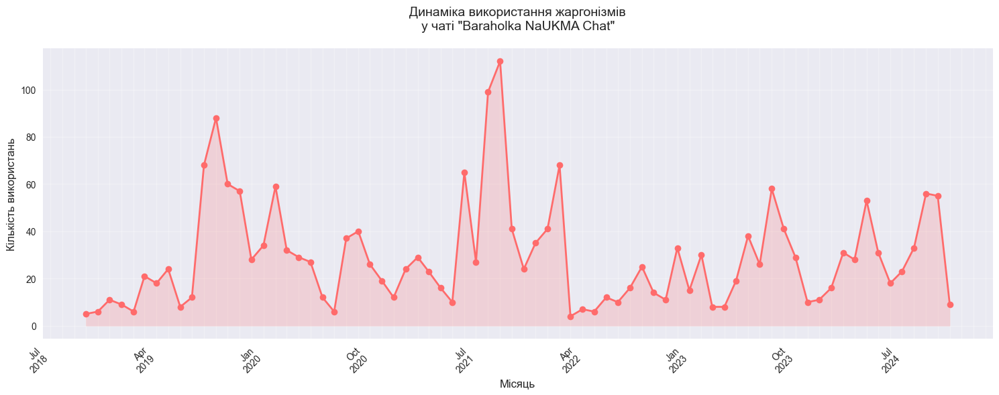

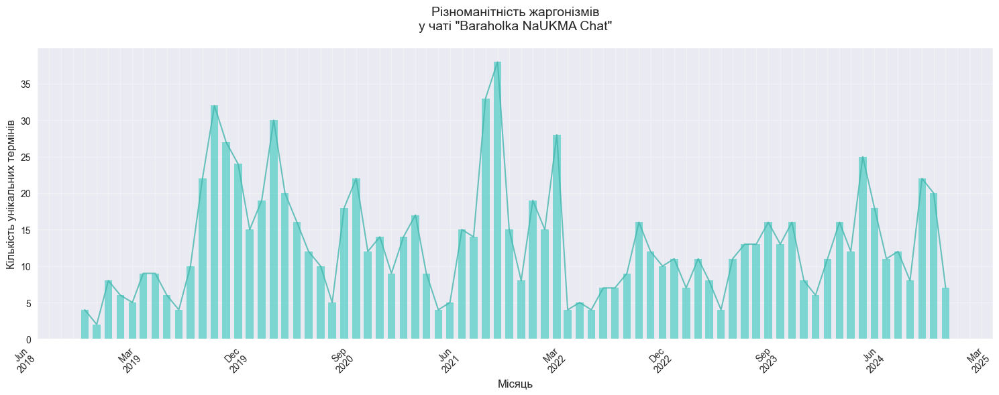

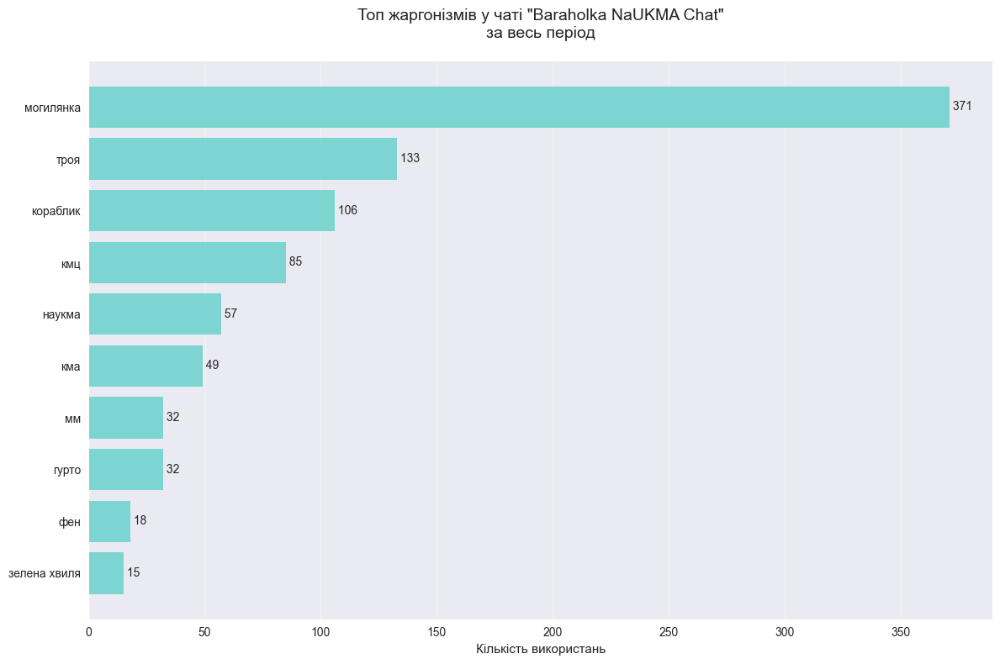

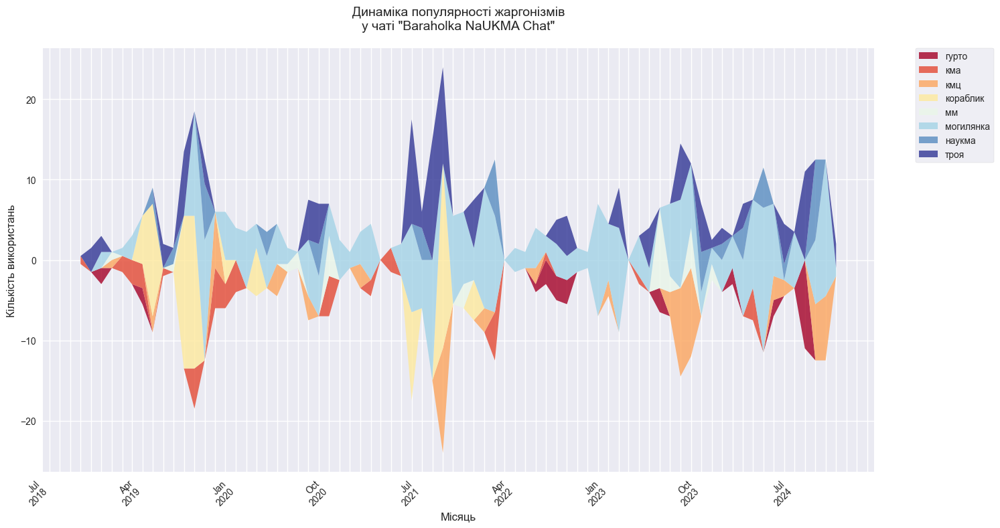

In [68]:
# Використання:
# Baraholka NaUKMA Chat
dialog_id = "-1001218251741"
monthly_data = analyze_chat_jargon_monthly(dialog_id, df, df_meta, jargon_forms)

# Створення візуалізацій топових жаргонізмів
create_top_terms_bar(monthly_data, dialog_id, df_meta)
create_terms_stream(monthly_data, dialog_id, df_meta)

C:\Users\Dmytro\AppData\Local\Temp\ipykernel_5652\1302114064.py:14: FutureWarning:

In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`



Аналізуємо повідомлення по місяцях...


100%|████████████████████████████████████████████████████████████████████████| 839512/839512 [11:06<00:00, 1259.52it/s]


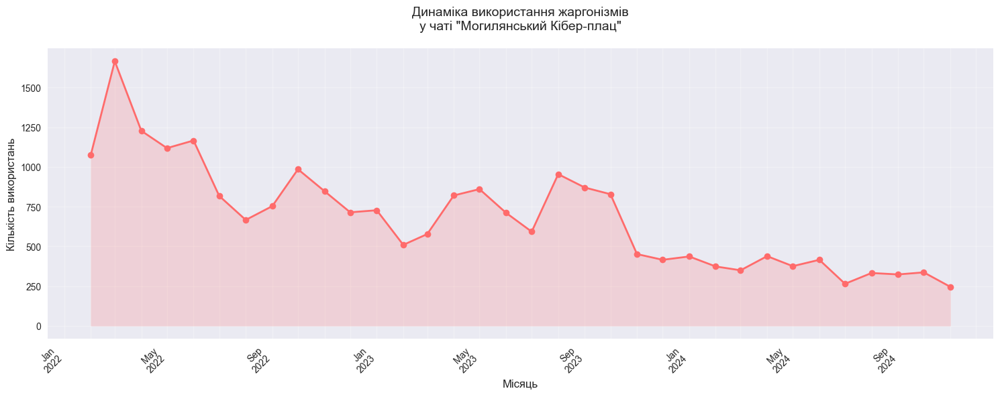

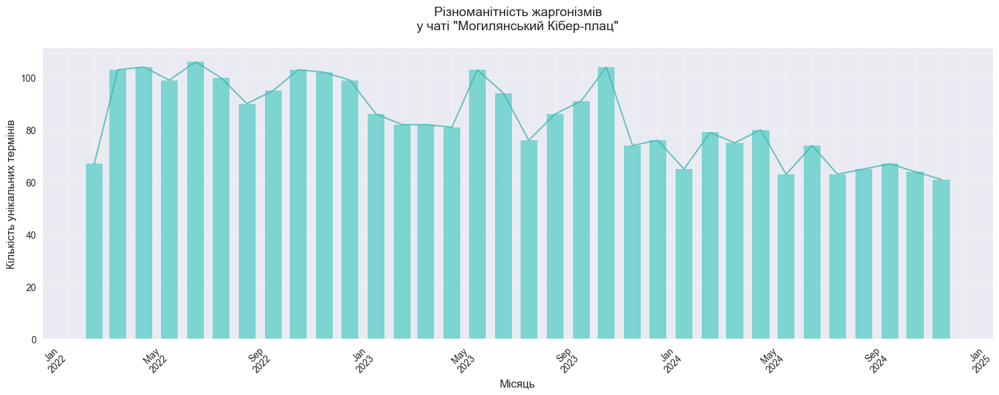

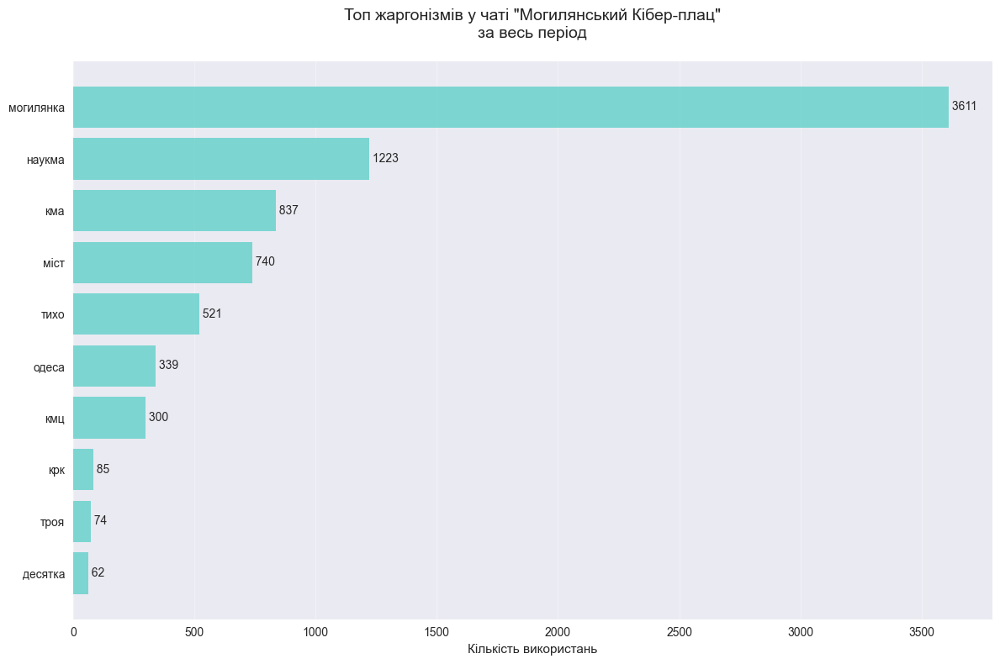

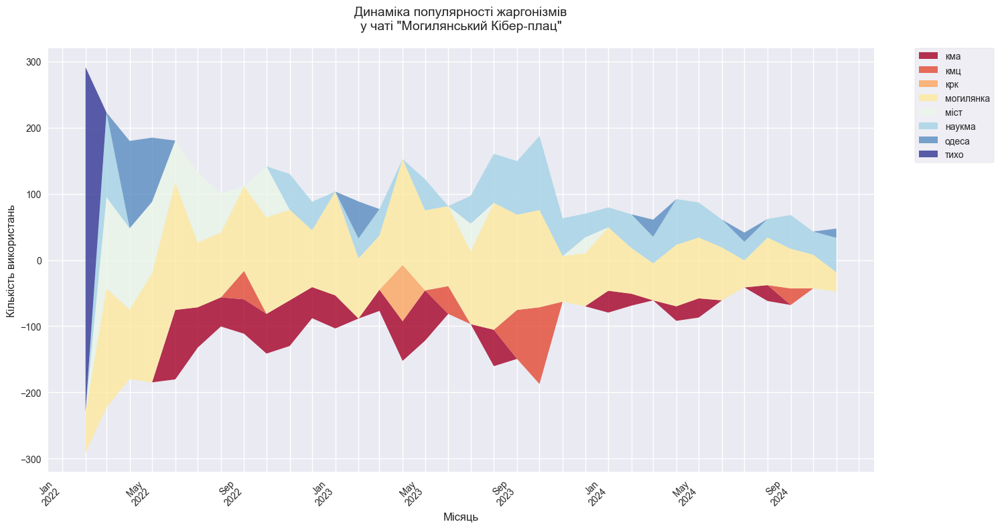

In [69]:
# Використання:
# Могилянський Кібер-плац
dialog_id = "-1001695031361"
monthly_data = analyze_chat_jargon_monthly(dialog_id, df, df_meta, jargon_forms)

# Створення візуалізацій топових жаргонізмів
create_top_terms_bar(monthly_data, dialog_id, df_meta)
create_terms_stream(monthly_data, dialog_id, df_meta)

**Висновок**

Помітно як з часом змінюється використання жаргонів. Також прослідковується деяка сезонність, яку можна пояснити з семестром, канікулами, сесією.

## Загальний висновок

Загалом в роботі досліджено переважно динаміку моїх повідомлень і взаємодію інших/ з іншими. Велику частину роботи складає аналіз використання могилянського жаргону в чатах
У ході цього я виявив з ким та коли я переважно спілкувався. Як змінювалася динаміка, та як це було пов'язано з декими змінами в житті (школа, університет, симпатії).
Також я дослідив популярність використання реакцій у мене та в близьких друзів. 
Далі я дослідив часові піки активності, і вони виявились доволі закономірними та послідовними.
Загалом прослідковується певна тенденція та послідовність змін. 
В останній частині роботи досліджено використання могилянського жаргону в різних могилянських чатах. 